In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
!cp "/content/drive/MyDrive/CoralMask1000/CoralMask1000.zip" /content/

In [ ]:
!unzip -q /content/CoralMask1000.zip -d /content/CoralMask1000

replace /content/CoralMask1000/__MACOSX/._CoralMaskCopy? [y]es, [n]o, [A]ll, [N]one, [r]ename: 

In [ ]:
!cp "/content/drive/MyDrive/CoralMaskUpload/CoralMask.zip" /content/

In [ ]:
!unzip -q /content/CoralMask.zip -d /content/CoralMask

/usr/local/lib/python3.11/dist-packages/albumentations/__init__.py:28: UserWarning: A new version of Albumentations is available: '2.0.8' (you have '2.0.7'). Upgrade using: pip install -U albumentations. To disable automatic update checks, set the environment variable NO_ALBUMENTATIONS_UPDATE to 1.
  check_for_updates()
Generating masks: 100%|██████████| 38098/38098 [09:20<00:00, 67.94it/s]



Missing images: []
Cleaning up 0 invalid JSON files...

Visualizing sample results:


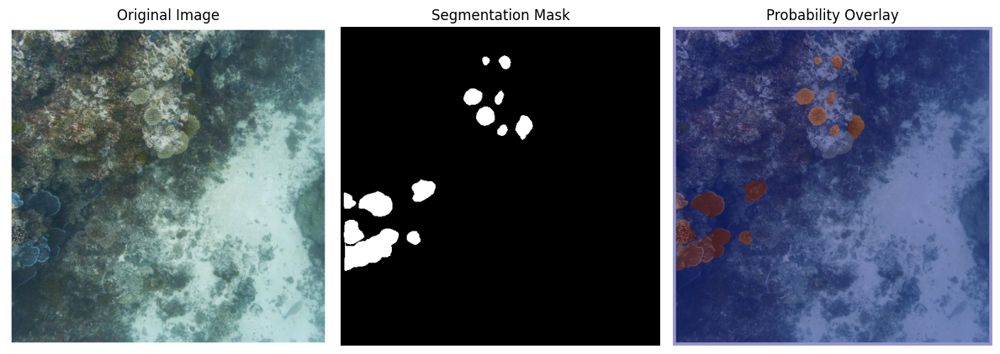

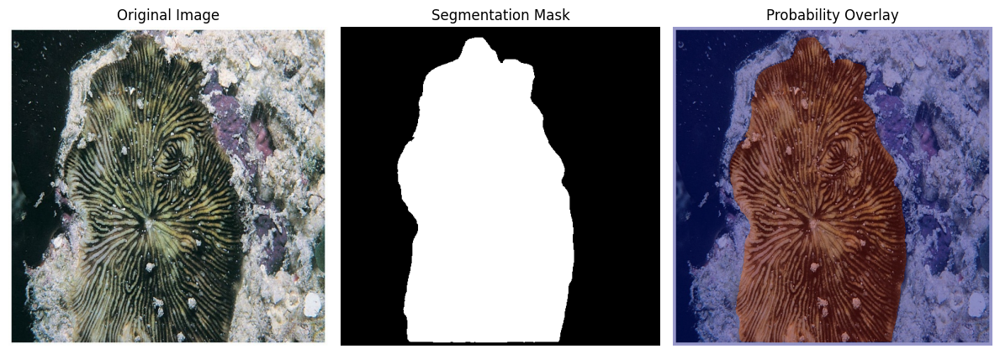

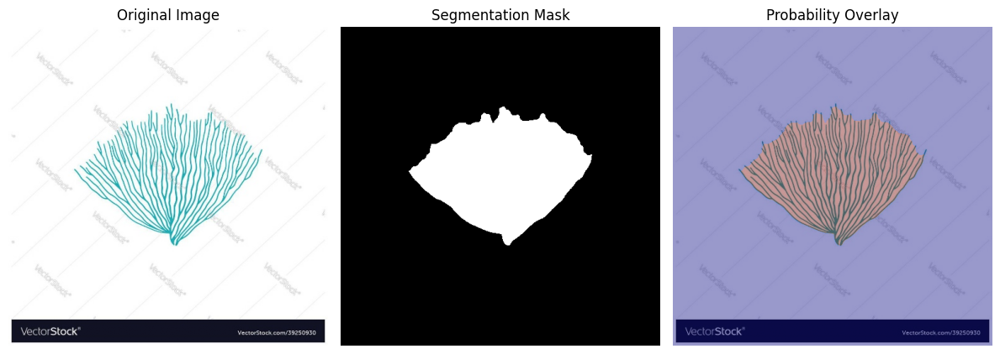

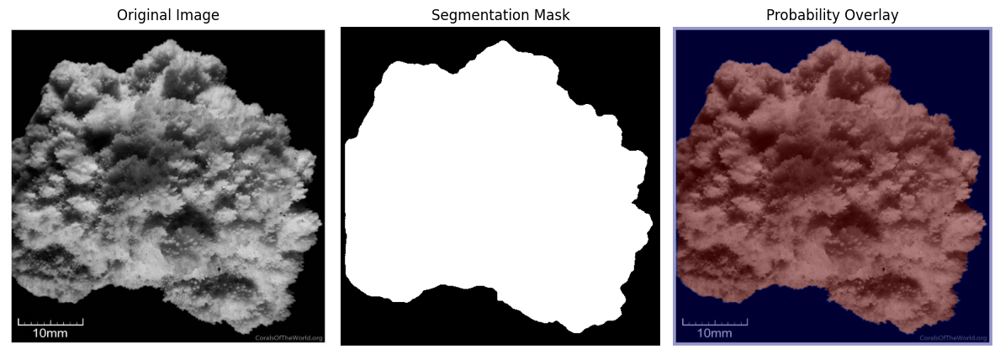

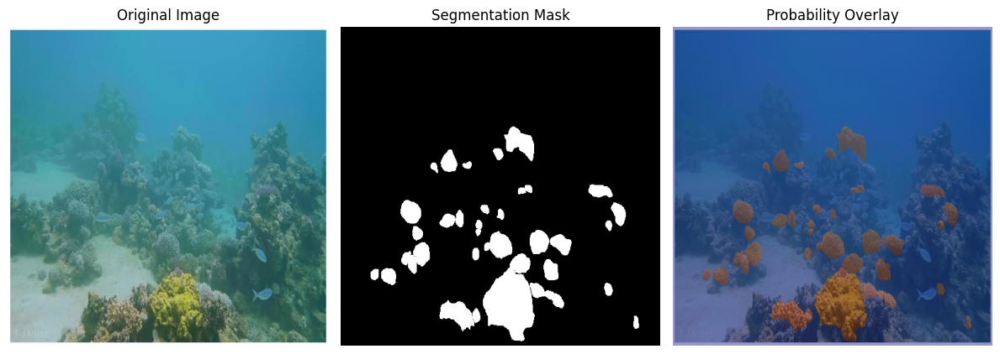


Dataset Validation Report:
Total images: 38098
Unannotated images: 0
Valid masks: 38098
Missing masks: 0
Empty masks: 0 (Deleted)
Class distribution - Coral: 4109941555, Background: 5877220557
Coral/Background ratio: 0.6993


Generating masks: 100%|██████████| 830/830 [00:21<00:00, 38.19it/s]



Missing images: []
Cleaning up 0 invalid JSON files...

Visualizing sample results:


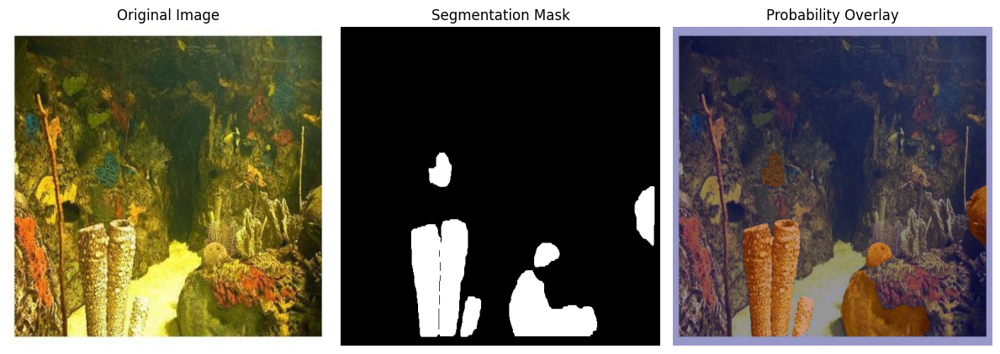

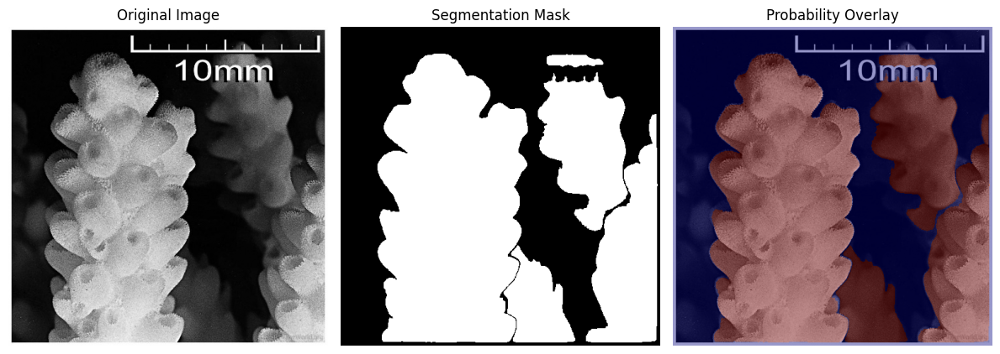

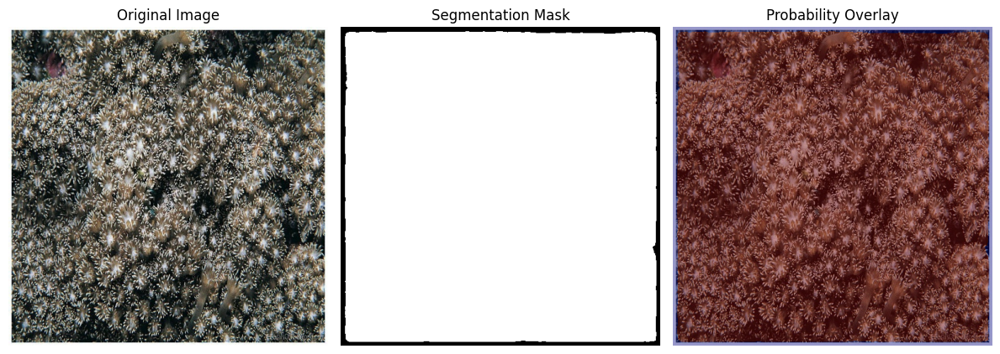

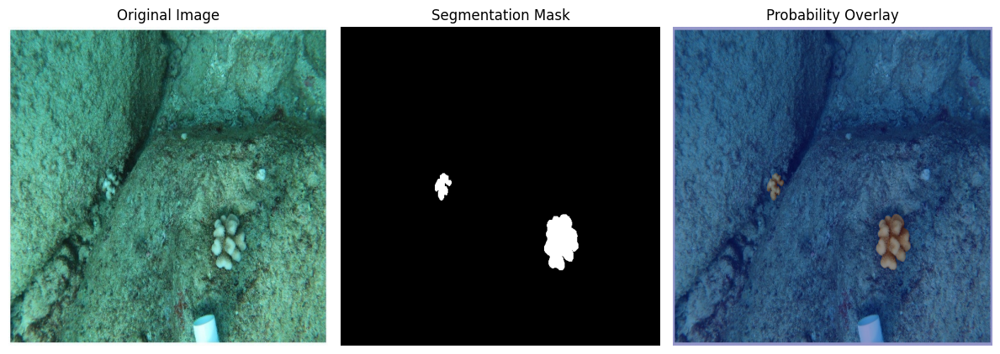

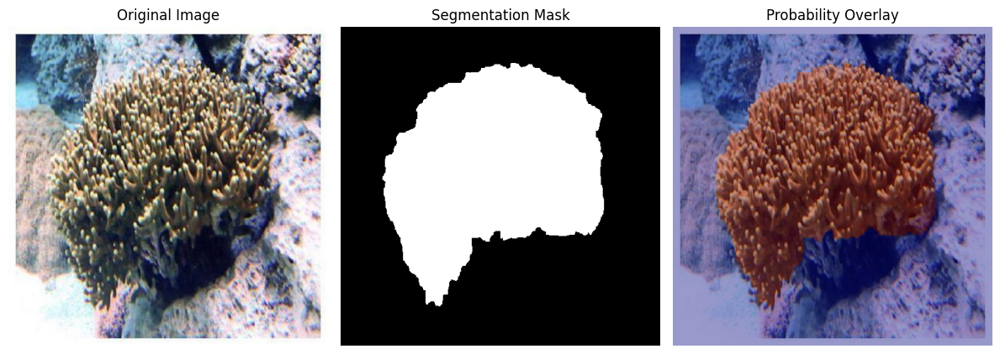


Dataset Validation Report:
Total images: 830
Unannotated images: 0
Valid masks: 830
Missing masks: 0
Empty masks: 0 (Deleted)
Class distribution - Coral: 68475597, Background: 149103923
Coral/Background ratio: 0.4592
Setup complete! Ready for model training.


In [ ]:
#%% Imports & Configuration
import os
import json
import numpy as np
import cv2
import torch
import torch.nn as nn
from torch.utils.data import Dataset, DataLoader
from pathlib import Path
from concurrent.futures import ThreadPoolExecutor
from tqdm import tqdm
from pycocotools import mask as maskUtils
import albumentations as A
from albumentations.pytorch import ToTensorV2
import matplotlib.pyplot as plt

%matplotlib inline

__all__ = ['CoralDataset']

# ====================== Configuration ======================
BASE_DIR = Path("/content/CoralMask/CoralMask")
DATASET_SPLITS = ["train", "test"]
IMAGE_EXTENSIONS = {'.jpg', '.jpeg', '.png'}
MASK_EXTENSION = '.png'
IMG_SIZE = (512, 512)
MAX_WORKERS = 8
NUM_SAMPLES_TO_VISUALIZE = 5
BATCH_SIZE = 16
DEVICE = torch.device("cuda" if torch.cuda.is_available() else "cpu")

#%% 1. Enhanced Mask Generation with Underwater Preprocessing
class CoralPreprocessor:
    @staticmethod
    def underwater_correction(image):
        lab = cv2.cvtColor(image, cv2.COLOR_BGR2LAB)
        l, a, b = cv2.split(lab)
        clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8, 8))
        cl = clahe.apply(l)
        merged = cv2.merge((cl, a, b))
        return cv2.cvtColor(merged, cv2.COLOR_LAB2BGR)

    @staticmethod
    def turbidity_simulation(image):
        image = cv2.GaussianBlur(image, (5, 5), 0)
        noise = np.random.normal(0, 25, image.shape).astype(np.uint8)
        return cv2.addWeighted(image, 0.75, noise, 0.25, 0)

def process_single_json(json_path, image_dir, mask_dir):
    try:
        with open(json_path, 'r') as f:
            data = json.load(f)

        image_file = data['image']['file_name']
        image_path = image_dir / image_file
        if not image_path.exists():
            print(f"Missing image: {image_file}")
            return None

        raw_image = cv2.imread(str(image_path))
        if raw_image is None:
            print(f"Failed to load image: {image_path}")
            return None

        resized_image = cv2.resize(raw_image, IMG_SIZE)

        processed_dir = image_dir.parent / "images_processed"
        processed_dir.mkdir(parents=True, exist_ok=True)
        processed_image_path = processed_dir / image_file
        cv2.imwrite(str(processed_image_path), resized_image)

        orig_h, orig_w = data['image']['height'], data['image']['width']
        combined_mask = np.zeros((orig_h, orig_w), dtype=np.uint8)

        annotations = data.get('annotations', [])
        if not annotations:
            print(f"Warning: No annotations for {image_file}")
            return None

        for ann in annotations:
            segmentation = ann.get('segmentation')
            if segmentation:
                ann_mask = maskUtils.decode(segmentation)
                if ann_mask is not None:
                    combined_mask = np.maximum(combined_mask, ann_mask)

        if np.sum(combined_mask) == 0:
            print(f"Warning: Empty mask for {image_file}")
            return None

        if combined_mask.dtype != np.uint8:
            combined_mask = (combined_mask > 0).astype(np.uint8)

        resized_mask = cv2.resize(combined_mask, IMG_SIZE, interpolation=cv2.INTER_NEAREST)
        mask_path = mask_dir / f"{json_path.stem}_mask{MASK_EXTENSION}"
        cv2.imwrite(str(mask_path), (resized_mask * 255).astype(np.uint8))

        return (processed_image_path, mask_path)

    except Exception as e:
        print(f"Error processing {json_path.name}: {str(e)}")
        return None

#%% 2. Dataset Validation & Class Analysis
def validate_dataset(image_dir, mask_dir, json_dir):
    missing_masks = []
    unannotated_images = []
    empty_masks = []
    class_dist = {'coral': 0, 'background': 0}

    total_images = len(list(image_dir.glob('*')))

    for img_path in image_dir.glob('*'):
        json_path = json_dir / f"{img_path.stem}.json"
        mask_path = mask_dir / f"{img_path.stem}_mask{MASK_EXTENSION}"

        if not json_path.exists():
            unannotated_images.append(img_path.name)
            continue

        if not mask_path.exists():
            missing_masks.append(img_path.name)
            continue

        mask = cv2.imread(str(mask_path), cv2.IMREAD_GRAYSCALE)
        if np.sum(mask) == 0:
            empty_masks.append(img_path.name)
            mask_path.unlink()
            continue

        class_dist['coral'] += np.sum(mask > 0)
        class_dist['background'] += np.sum(mask == 0)

    print(f"\nDataset Validation Report:")
    print(f"Total images: {total_images}")
    print(f"Unannotated images: {len(unannotated_images)}")
    print(f"Valid masks: {total_images - len(missing_masks) - len(unannotated_images)}")
    print(f"Missing masks: {len(missing_masks)}")
    print(f"Empty masks: {len(empty_masks)} (Deleted)")
    print(f"Class distribution - Coral: {class_dist['coral']}, Background: {class_dist['background']}")
    if class_dist['background'] > 0:
        ratio = class_dist['coral'] / class_dist['background']
        print(f"Coral/Background ratio: {ratio:.4f}")
    else:
        print("Coral/Background ratio: Undefined")

#%% 3. Generate Masks Function
def generate_masks(dataset_split):
    dataset_dir = BASE_DIR / dataset_split
    image_dir = dataset_dir / "images"
    json_dir = dataset_dir / "jsons"
    mask_dir = dataset_dir / "masks"

    mask_dir.mkdir(parents=True, exist_ok=True)
    json_files = list(json_dir.glob("*.json"))

    missing_images = []
    bad_jsons = []

    results = []
    with ThreadPoolExecutor(max_workers=MAX_WORKERS) as executor:
        futures = {executor.submit(process_single_json, p, image_dir, mask_dir): p for p in json_files}
        for future in tqdm(futures, desc="Generating masks"):
            if (result := future.result()) is None:
                bad_json = futures[future]
                bad_jsons.append(bad_json)
                with open(bad_json, 'r') as f:
                    data = json.load(f)
                missing_images.append(data['image']['file_name'])
            else:
                results.append(result)

    print(f"\nMissing images: {missing_images}")
    print(f"Cleaning up {len(bad_jsons)} invalid JSON files...")
    for bad_json in bad_jsons:
        bad_json.unlink()

    print("\nVisualizing sample results:")
    for idx in np.random.choice(len(results), min(NUM_SAMPLES_TO_VISUALIZE, len(results)), replace=False):
        visualize_comparison(*results[idx])

#%% 4. Visualization Function
def visualize_comparison(image_path, mask_path):
    plt.figure(figsize=(12, 6))

    image = cv2.cvtColor(cv2.imread(str(image_path)), cv2.COLOR_BGR2RGB)
    image = cv2.resize(image, IMG_SIZE)
    image = np.clip(image / 255.0, 0, 1)
    mask = cv2.imread(str(mask_path), cv2.IMREAD_GRAYSCALE)

    norm_mask = mask.astype(float)/float(mask.max()) if mask.max() > 0 else mask

    plt.subplot(1, 3, 1)
    plt.imshow(image)
    plt.title("Original Image")
    plt.axis('off')

    plt.subplot(1, 3, 2)
    plt.imshow(mask, cmap='gray')
    plt.title("Segmentation Mask")
    plt.axis('off')

    plt.subplot(1, 3, 3)
    plt.imshow(image)
    plt.imshow(norm_mask, alpha=0.4, cmap='jet')
    plt.title("Probability Overlay")
    plt.axis('off')

    plt.tight_layout()
    plt.show()

#%% 5. Dataset Class
class CoralDataset(Dataset):
    def __init__(self, image_dir, mask_dir, transform=None):
        self.image_dir = image_dir
        self.mask_dir = mask_dir
        self.transform = transform

        self.image_paths = []
        for p in image_dir.glob('*'):
            if p.suffix.lower() not in IMAGE_EXTENSIONS:
                continue
            mask_path = mask_dir / f"{p.stem}_mask{MASK_EXTENSION}"
            if not mask_path.exists():
                raise FileNotFoundError(f"Missing mask for {p.name}")
            self.image_paths.append(p)

        self.pos_weight = self._calculate_class_weights()

    def _calculate_class_weights(self):
        coral_pixels = 0
        background_pixels = 0
        smooth = 1e-6

        for mask_path in self.mask_dir.glob('*'):
            mask = cv2.imread(str(mask_path), cv2.IMREAD_GRAYSCALE)
            coral_pixels += np.sum(mask > 0)
            background_pixels += np.sum(mask == 0)

        pos_weight = (background_pixels + smooth) / (coral_pixels + smooth)
        return torch.tensor(pos_weight, dtype=torch.float32)

    def __len__(self):
        return len(self.image_paths)

    def __getitem__(self, idx):
        img_path = self.image_paths[idx]
        mask_path = self.mask_dir / f"{img_path.stem}_mask{MASK_EXTENSION}"

        image = cv2.imread(str(img_path))
        if image is None:
            raise FileNotFoundError(f"Image not found: {img_path}")
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

        mask = cv2.imread(str(mask_path), cv2.IMREAD_GRAYSCALE)
        if mask is None:
            raise FileNotFoundError(f"Mask not found: {mask_path}")
        mask = (mask > 0).astype(np.uint8)

        if self.transform:
            transformed = self.transform(image=image, mask=mask)
            image = transformed['image']
            mask = transformed['mask']

            if mask.dim() == 2:
                mask = mask.unsqueeze(0)
        else:
            image = cv2.resize(image, IMG_SIZE)
            mask = cv2.resize(mask, IMG_SIZE, interpolation=cv2.INTER_NEAREST)
            image = torch.from_numpy(image).permute(2, 0, 1).float() / 255.0
            mask = torch.from_numpy(mask).float().unsqueeze(0)

        return image, mask


#%% 6. Albumentations Transform
import albumentations as A
from albumentations.pytorch import ToTensorV2

train_transform = A.Compose([
    A.Resize(512, 512),
    A.HorizontalFlip(p=0.5),
    A.Rotate(limit=10, p=0.5),
    A.RandomBrightnessContrast(p=0.5),
    A.HueSaturationValue(p=0.4),
    A.Normalize(mean=[0.485, 0.456, 0.406],
                std=[0.229, 0.224, 0.225]),
    ToTensorV2()
])


val_transform = A.Compose([
    A.Resize(512, 512),
    A.Normalize(mean=[0.485, 0.456, 0.406],
                std=[0.229, 0.224, 0.225]),
    ToTensorV2()
])


#%% 7. Main Execution
if __name__ == "__main__":
    torch.backends.cudnn.benchmark = True
    for split in DATASET_SPLITS:
        generate_masks(split)
        validate_dataset(
            BASE_DIR/split/"images_processed",
            BASE_DIR/split/"masks",
            BASE_DIR/split/"jsons"
        )

    print("Setup complete! Ready for model training.")

In [ ]:
import torch
import torch.nn as nn
import torch.nn.functional as F

class SEBlock(nn.Module):
    def __init__(self, channels, reduction=16):
        super().__init__()
        self.fc1 = nn.Linear(channels, channels // reduction)
        self.fc2 = nn.Linear(channels // reduction, channels)

    def forward(self, x):
        batch, c, h, w = x.size()
        y = F.adaptive_avg_pool2d(x, 1).view(batch, c)
        y = F.relu(self.fc1(y))
        y = torch.sigmoid(self.fc2(y)).view(batch, c, 1, 1)
        return x * y

class DoubleConv(nn.Module):
    def __init__(self, in_channels, out_channels, mid_channels=None, dropout=0.1):
        super().__init__()
        mid_channels = mid_channels or out_channels
        self.double_conv = nn.Sequential(
            nn.Conv2d(in_channels, mid_channels, kernel_size=3, padding=1),
            nn.BatchNorm2d(mid_channels),
            nn.ReLU(inplace=True),
            SEBlock(mid_channels),
            nn.Dropout2d(p=dropout),
            nn.Conv2d(mid_channels, out_channels, kernel_size=3, padding=1),
            nn.BatchNorm2d(out_channels),
            nn.ReLU(inplace=True),
            SEBlock(out_channels)
        )

    def forward(self, x):
        return self.double_conv(x)

class Down(nn.Module):
    def __init__(self, in_channels, out_channels):
        super().__init__()
        self.maxpool_conv = nn.Sequential(
            nn.MaxPool2d(2),
            DoubleConv(in_channels, out_channels)
        )

    def forward(self, x):
        return self.maxpool_conv(x)

class Up(nn.Module):
    def __init__(self, in_channels, out_channels, bilinear=True):
        super().__init__()
        if bilinear:
            self.up = nn.Upsample(scale_factor=2, mode='bilinear', align_corners=True)
            self.conv = DoubleConv(in_channels, out_channels, in_channels // 2)
        else:
            self.up = nn.ConvTranspose2d(in_channels, in_channels // 2, kernel_size=2, stride=2)
            self.conv = DoubleConv(in_channels, out_channels)

    def forward(self, x1, x2):
        x1 = self.up(x1)
        diffY = x2.size(2) - x1.size(2)
        diffX = x2.size(3) - x1.size(3)
        x1 = F.pad(x1, [diffX // 2, diffX - diffX // 2,
                        diffY // 2, diffY - diffY // 2])
        x = torch.cat([x2, x1], dim=1)
        return self.conv(x)

class OutConv(nn.Module):
    def __init__(self, in_channels, out_channels):
        super().__init__()
        self.conv = nn.Conv2d(in_channels, out_channels, kernel_size=1)

    def forward(self, x):
        return self.conv(x)

class UNet(nn.Module):
    def __init__(self, n_channels=3, n_classes=1, bilinear=True):
        super().__init__()
        self.inc = DoubleConv(n_channels, 32)
        self.down1 = Down(32, 64)
        self.down2 = Down(64, 128)
        self.down3 = Down(128, 256)
        factor = 2 if bilinear else 1
        self.down4 = Down(256, 512 // factor)
        self.up1 = Up(512, 256 // factor, bilinear)
        self.up2 = Up(256, 128 // factor, bilinear)
        self.up3 = Up(128, 64 // factor, bilinear)
        self.up4 = Up(64, 32, bilinear)
        self.outc = OutConv(32, n_classes)

        self._initialize_weights()

    def forward(self, x):
        x1 = self.inc(x)
        x2 = self.down1(x1)
        x3 = self.down2(x2)
        x4 = self.down3(x3)
        x5 = self.down4(x4)
        x = self.up1(x5, x4)
        x = self.up2(x, x3)
        x = self.up3(x, x2)
        x = self.up4(x, x1)
        return self.outc(x)

    def _initialize_weights(self):
        for m in self.modules():
            if isinstance(m, nn.Conv2d):
                nn.init.kaiming_normal_(m.weight, nonlinearity='relu')
                if m.bias is not None:
                    nn.init.zeros_(m.bias)
            elif isinstance(m, nn.BatchNorm2d):
                nn.init.ones_(m.weight)
                nn.init.zeros_(m.bias)
            elif isinstance(m, nn.Linear):
                nn.init.kaiming_normal_(m.weight, nonlinearity='relu')
                nn.init.zeros_(m.bias)


In [ ]:
# 1. Imports
import torch
import torch.nn as nn
import torch.nn.functional as F
from torchvision.models.segmentation import deeplabv3_mobilenet_v3_large, DeepLabV3_MobileNet_V3_Large_Weights

# 2. ASPP First
class ASPP(nn.Module):
    def __init__(self, in_channels, out_channels):
        super(ASPP, self).__init__()
        self.atrous_block1 = nn.Sequential(
            nn.Conv2d(in_channels, out_channels, kernel_size=1, bias=False),
            nn.BatchNorm2d(out_channels),
            nn.ReLU()
        )
        self.atrous_block6 = nn.Sequential(
            nn.Conv2d(in_channels, out_channels, kernel_size=3, padding=6, dilation=6, bias=False),
            nn.BatchNorm2d(out_channels),
            nn.ReLU()
        )
        self.atrous_block12 = nn.Sequential(
            nn.Conv2d(in_channels, out_channels, kernel_size=3, padding=12, dilation=12, bias=False),
            nn.BatchNorm2d(out_channels),
            nn.ReLU()
        )
        self.atrous_block18 = nn.Sequential(
            nn.Conv2d(in_channels, out_channels, kernel_size=3, padding=18, dilation=18, bias=False),
            nn.BatchNorm2d(out_channels),
            nn.ReLU()
        )
        self.image_pool = nn.Sequential(
            nn.AdaptiveAvgPool2d((1, 1)),
            nn.Conv2d(in_channels, out_channels, kernel_size=1, bias=False),
            nn.BatchNorm2d(out_channels),
            nn.ReLU()
        )
        self.conv1 = nn.Conv2d(out_channels * 5, out_channels, kernel_size=1, bias=False)
        self.bn1 = nn.BatchNorm2d(out_channels)
        self.relu = nn.ReLU()
        self.dropout = nn.Dropout(0.5)

    def forward(self, x):
        size = x.shape[-2:]
        image_features = self.image_pool(x)
        image_features = F.interpolate(image_features, size=size, mode='bilinear', align_corners=False)
        out = torch.cat([
            self.atrous_block1(x),
            self.atrous_block6(x),
            self.atrous_block12(x),
            self.atrous_block18(x),
            image_features
        ], dim=1)
        out = self.conv1(out)
        out = self.bn1(out)
        out = self.relu(out)
        return self.dropout(out)

# 3. Decoder Class (after ASPP is defined)
class DeepLabV3PlusDecoder(nn.Module):
    def __init__(self, num_classes=1):
        super().__init__()
        base_model = deeplabv3_mobilenet_v3_large(weights=DeepLabV3_MobileNet_V3_Large_Weights.DEFAULT)
        self.backbone = base_model.backbone
        self.aspp = ASPP(960, 256)

        self.low_level_proj = nn.Sequential(
            nn.Conv2d(40, 48, kernel_size=1, bias=False),
            nn.BatchNorm2d(48),
            nn.ReLU(inplace=True)
        )

        self.decoder = nn.Sequential(
            nn.Conv2d(256 + 48, 256, kernel_size=3, padding=1, bias=False),
            nn.BatchNorm2d(256),
            nn.ReLU(inplace=True),
            nn.Conv2d(256, 256, kernel_size=3, padding=1, bias=False),
            nn.BatchNorm2d(256),
            nn.ReLU(inplace=True),
            nn.Conv2d(256, num_classes, kernel_size=1)
        )

    def forward(self, x):
        input_size = x.shape[-2:]
        low_level_feat = None
        for name, module in self.backbone.named_children():
            x = module(x)
            if name == "4":
                low_level_feat = x
            if name == "16":
                break

        high_level_feat = self.aspp(x)
        low_level_feat = self.low_level_proj(low_level_feat)

        high_level_feat = F.interpolate(high_level_feat, size=low_level_feat.shape[2:], mode="bilinear", align_corners=False)
        x = torch.cat([high_level_feat, low_level_feat], dim=1)
        x = self.decoder(x)
        x = F.interpolate(x, size=input_size, mode="bilinear", align_corners=False)
        return x

In [ ]:
import torch
import torch.nn as nn
import torch.nn.functional as F
from torchvision.models.resnet import BasicBlock


def conv3x3(in_planes, out_planes, stride=1):
    return nn.Conv2d(in_planes, out_planes, kernel_size=3, stride=stride, padding=1, bias=False)

class SafeBasicBlock(nn.Module):
    def __init__(self, inplanes, planes):
        super().__init__()
        self.conv1 = conv3x3(inplanes, planes)
        self.bn1 = nn.BatchNorm2d(planes)
        self.relu = nn.ReLU(inplace=False)
        self.conv2 = conv3x3(planes, planes)
        self.bn2 = nn.BatchNorm2d(planes)

        self.downsample = None
        if inplanes != planes:
            self.downsample = nn.Sequential(
                nn.Conv2d(inplanes, planes, kernel_size=1, bias=False),
                nn.BatchNorm2d(planes)
            )

    def forward(self, x):
        identity = x
        out = self.relu(self.bn1(self.conv1(x)))
        out = self.bn2(self.conv2(out))
        if self.downsample is not None:
            identity = self.downsample(identity)
        out = out + identity
        return self.relu(out)


BasicBlock = SafeBasicBlock


class HRNetBlock(nn.Module):
    def __init__(self, in_channels, out_channels, num_blocks):
        super().__init__()
        self.blocks = nn.Sequential(
            *[BasicBlock(in_channels if i == 0 else out_channels, out_channels) for i in range(num_blocks)]
        )

    def forward(self, x):
        return self.blocks(x)

class FuseLayer(nn.Module):
    def __init__(self, num_branches, channels):
        super().__init__()
        self.num_branches = num_branches
        self.channels = channels
        self.fuse_layers = nn.ModuleList()

        for i in range(num_branches):
            fuse = nn.ModuleList()
            for j in range(num_branches):
                if i == j:
                    fuse.append(nn.Identity())
                elif i < j:
                    fuse.append(nn.Sequential(
                        nn.Conv2d(channels[j], channels[i], 1, bias=False),
                        nn.BatchNorm2d(channels[i]),
                        nn.Upsample(scale_factor=2**(j - i), mode='bilinear', align_corners=True)
                    ))
                else:
                    downs = []
                    for k in range(i - j):
                        in_ch = channels[j] if k == 0 else channels[i]
                        downs.append(nn.Sequential(
                            nn.Conv2d(in_ch, channels[i], 3, stride=2, padding=1, bias=False),
                            nn.BatchNorm2d(channels[i]),
                            nn.ReLU(inplace=False)
                        ))
                    fuse.append(nn.Sequential(*downs))
            self.fuse_layers.append(fuse)

    def forward(self, x):
        fused = []
        for i in range(self.num_branches):
            y = self.fuse_layers[i][0](x[0])
            for j in range(1, self.num_branches):
                y = y + self.fuse_layers[i][j](x[j])
            fused.append(F.relu(y))
        return fused

class HRStage(nn.Module):
    def __init__(self, num_branches, num_blocks, channels):
        super().__init__()
        self.branches = nn.ModuleList([
            HRNetBlock(channels[i], channels[i], num_blocks) for i in range(num_branches)
        ])
        self.fuse = FuseLayer(num_branches, channels)

    def forward(self, x):
        x = [branch(xi) for branch, xi in zip(self.branches, x)]
        x = self.fuse(x)
        return x

class HRNetV2(nn.Module):
    def __init__(self, in_channels=3, num_classes=1):
        super().__init__()
        self.stem = nn.Sequential(
            conv3x3(in_channels, 64, stride=2),
            nn.BatchNorm2d(64),
            nn.ReLU(inplace=False),
            conv3x3(64, 64, stride=2),
            nn.BatchNorm2d(64),
            nn.ReLU(inplace=False)
        )

        self.stage1 = HRNetBlock(64, 64, num_blocks=4)

        self.transition1 = nn.ModuleList([
            nn.Identity(),
            nn.Sequential(
                conv3x3(64, 128, stride=2),
                nn.BatchNorm2d(128),
                nn.ReLU(inplace=False)
            )
        ])

        self.stage2 = HRStage(num_branches=2, num_blocks=4, channels=[64, 128])

        self.transition2 = nn.ModuleList([
            nn.Identity(),
            nn.Identity(),
            nn.Sequential(
                conv3x3(128, 256, stride=2),
                nn.BatchNorm2d(256),
                nn.ReLU(inplace=False)
            )
        ])

        self.stage3 = HRStage(num_branches=3, num_blocks=4, channels=[64, 128, 256])

        self.transition3 = nn.ModuleList([
            nn.Identity(),
            nn.Identity(),
            nn.Identity(),
            nn.Sequential(
                conv3x3(256, 512, stride=2),
                nn.BatchNorm2d(512),
                nn.ReLU(inplace=False)
            )
        ])

        self.stage4 = HRStage(num_branches=4, num_blocks=4, channels=[64, 128, 256, 512])

        self.head = nn.Sequential(
            nn.Conv2d(64 + 128 + 256 + 512, 512, 1, bias=False),
            nn.BatchNorm2d(512),
            nn.ReLU(inplace=False),
            nn.Conv2d(512, num_classes, 1)
        )

    def forward(self, x):
        B, C, H, W = x.shape
        x = self.stem(x)
        x = self.stage1(x)

        x_list = [self.transition1[0](x), self.transition1[1](x)]
        x_list = self.stage2(x_list)

        x_list = [self.transition2[i](x_list[i]) for i in range(2)] + [self.transition2[2](x_list[1])]
        x_list = self.stage3(x_list)

        x_list = [self.transition3[i](x_list[i]) for i in range(3)] + [self.transition3[3](x_list[2])]
        x_list = self.stage4(x_list)

        # Upsample all to 1/4 resolution (same as x_list[0]) and concatenate
        x_up = [F.interpolate(feat, size=x_list[0].shape[2:], mode='bilinear', align_corners=True) for feat in x_list]
        x_cat = torch.cat(x_up, dim=1)

        out = self.head(x_cat)
        out = F.interpolate(out, size=(H, W), mode='bilinear', align_corners=True)
        return out


In [ ]:
import torch
import torch.nn as nn
import torch.nn.functional as F
from einops import rearrange


# ------------------------------
# 1. Patch Embedding (Conv-based)
# ------------------------------
class OverlapPatchEmbedding(nn.Module):
    def __init__(self, in_channels, embed_dim, patch_size=7, stride=4):
        super().__init__()
        self.proj = nn.Conv2d(in_channels, embed_dim, patch_size, stride, patch_size // 2)
        self.norm = nn.LayerNorm(embed_dim)

    def forward(self, x):
        x = self.proj(x)  # B x C x H' x W'
        _, _, H, W = x.shape
        x = rearrange(x, 'b c h w -> b (h w) c')
        x = self.norm(x)
        return x, H, W


# ------------------------------
# 2. Efficient Self-Attention
# ------------------------------
class EfficientSelfAttention(nn.Module):
    def __init__(self, dim, num_heads=8, sr_ratio=1):
        super().__init__()
        self.num_heads = num_heads
        self.head_dim = dim // num_heads
        self.scale = self.head_dim ** -0.5

        self.q = nn.Linear(dim, dim)
        self.kv = nn.Linear(dim, dim * 2)

        self.sr_ratio = sr_ratio
        if sr_ratio > 1:
            self.sr = nn.Conv2d(dim, dim, kernel_size=sr_ratio, stride=sr_ratio)
            self.norm = nn.LayerNorm(dim)

        self.proj = nn.Linear(dim, dim)

    def forward(self, x, H, W):
        B, N, C = x.shape
        q = self.q(x).reshape(B, N, self.num_heads, self.head_dim).permute(0, 2, 1, 3)

        if self.sr_ratio > 1:
            x_ = x.permute(0, 2, 1).reshape(B, C, H, W)
            x_ = self.sr(x_).reshape(B, C, -1).permute(0, 2, 1)
            x_ = self.norm(x_)
        else:
            x_ = x

        kv = self.kv(x_).reshape(B, -1, 2, self.num_heads, self.head_dim).permute(2, 0, 3, 1, 4)
        k, v = kv[0], kv[1]  # each: (B, heads, tokens, head_dim)

        attn = (q @ k.transpose(-2, -1)) * self.scale
        attn = attn.softmax(dim=-1)

        out = (attn @ v).transpose(1, 2).reshape(B, N, C)
        return self.proj(out)


# ------------------------------
# 3. Mix Feed-Forward Network
# ------------------------------
class MixFFN(nn.Module):
    def __init__(self, dim, hidden_dim):
        super().__init__()
        self.fc1 = nn.Linear(dim, hidden_dim)
        self.dwconv = nn.Conv2d(hidden_dim, hidden_dim, 3, padding=1, groups=hidden_dim)
        self.act = nn.GELU()
        self.fc2 = nn.Linear(hidden_dim, dim)

    def forward(self, x, H, W):
        x = self.fc1(x)
        x = self.act(x)
        x = rearrange(x, 'b (h w) c -> b c h w', h=H, w=W)
        x = self.dwconv(x)
        x = rearrange(x, 'b c h w -> b (h w) c')
        x = self.fc2(x)
        return x


# ------------------------------
# 4. Transformer Block
# ------------------------------
class TransformerEncoderBlock(nn.Module):
    def __init__(self, dim, num_heads, sr_ratio=1, mlp_ratio=4):
        super().__init__()
        self.norm1 = nn.LayerNorm(dim)
        self.attn = EfficientSelfAttention(dim, num_heads, sr_ratio)
        self.norm2 = nn.LayerNorm(dim)
        self.ffn = MixFFN(dim, int(dim * mlp_ratio))

    def forward(self, x, H, W):
        x = x + self.attn(self.norm1(x), H, W)
        x = x + self.ffn(self.norm2(x), H, W)
        return x


# ------------------------------
# 5. MiT Backbone (4 Stages)
# ------------------------------
class MiTBackbone(nn.Module):
    def __init__(self, in_channels=3, embed_dims=[64, 128, 320, 512], depths=[2, 2, 2, 2],
                 num_heads=[1, 2, 5, 8], sr_ratios=[8, 4, 2, 1]):
        super().__init__()
        self.stages = nn.ModuleList()
        self.blocks = nn.ModuleList()

        for i in range(4):
            patch_embed = OverlapPatchEmbedding(
                in_channels if i == 0 else embed_dims[i - 1],
                embed_dims[i],
                patch_size=7 if i == 0 else 3,
                stride=4 if i == 0 else 2
            )
            self.stages.append(patch_embed)
            self.blocks.append(
                nn.Sequential(*[
                    TransformerEncoderBlock(embed_dims[i], num_heads[i], sr_ratios[i])
                    for _ in range(depths[i])
                ])
            )

    def forward(self, x):
        features = []
        for stage, block in zip(self.stages, self.blocks):
            x, H, W = stage(x)
            for b in block:
                x = b(x, H, W)
            x = rearrange(x, 'b (h w) c -> b c h w', h=H, w=W)
            features.append(x)
        return features  # [P1, P2, P3, P4]


# ------------------------------
# 6. MLP Decoder
# ------------------------------
class MLPDecoder(nn.Module):
    def __init__(self, in_channels=[64, 128, 320, 512], embedding_dim=256, num_classes=1):
        super().__init__()
        self.linear_c = nn.ModuleList([
            nn.Sequential(
                nn.Conv2d(in_ch, embedding_dim, 1),
                nn.BatchNorm2d(embedding_dim),
                nn.ReLU(inplace=False)
            ) for in_ch in in_channels
        ])
        self.fuse = nn.Sequential(
            nn.Conv2d(embedding_dim * 4, embedding_dim, 1),
            nn.BatchNorm2d(embedding_dim),
            nn.ReLU(inplace=False),
            nn.Conv2d(embedding_dim, num_classes, 1)
        )

    def forward(self, features):
        _, _, H, W = features[0].shape
        resized = [
            F.interpolate(self.linear_c[i](feat), size=(H, W), mode='bilinear', align_corners=False)
            for i, feat in enumerate(features)
        ]
        fused = torch.cat(resized, dim=1)
        return self.fuse(fused)


# ------------------------------
# 7. Full SegFormer Model
# ------------------------------
class SegFormer(nn.Module):
    def __init__(self, num_classes=1):
        super().__init__()
        self.encoder = MiTBackbone()
        self.decoder = MLPDecoder(num_classes=num_classes)

    def forward(self, x):
        H, W = x.shape[2:]
        features = self.encoder(x)
        logits = self.decoder(features)
        return F.interpolate(logits, size=(H, W), mode='bilinear', align_corners=False)


In [ ]:

import torch
import torch.nn as nn
import torch.nn.functional as F
from torchvision.models import resnet18, ResNet18_Weights


# ------------------------
# 1. Attention Refinement Module (ARM)
# ------------------------
class AttentionRefinementModule(nn.Module):
    def __init__(self, in_channels):
        super().__init__()
        self.conv = nn.Sequential(
            nn.Conv2d(in_channels, in_channels, 3, padding=1, bias=False),
            nn.BatchNorm2d(in_channels),
            nn.ReLU(inplace=False)
        )
        self.attn = nn.Sequential(
            nn.AdaptiveAvgPool2d(1),
            nn.Conv2d(in_channels, in_channels, 1, bias=False),
            nn.BatchNorm2d(in_channels),
            nn.Sigmoid()
        )

    def forward(self, x):
        x = self.conv(x)
        attn = self.attn(x)
        return x * attn


# ------------------------
# 2. Feature Fusion Module (FFM)
# ------------------------
class FeatureFusionModule(nn.Module):
    def __init__(self, in_channels, out_channels):
        super().__init__()
        self.convblk = nn.Sequential(
            nn.Conv2d(in_channels, out_channels, 1, bias=False),
            nn.BatchNorm2d(out_channels),
            nn.ReLU(inplace=False)
        )
        self.attn = nn.Sequential(
            nn.AdaptiveAvgPool2d(1),
            nn.Conv2d(out_channels, out_channels // 4, 1, bias=False),
            nn.ReLU(inplace=False),
            nn.Conv2d(out_channels // 4, out_channels, 1, bias=False),
            nn.Sigmoid()
        )

    def forward(self, x):
        feat = self.convblk(x)
        attn = self.attn(feat)
        return feat + feat * attn


# ------------------------
# 3. Spatial Path
# ------------------------
class SpatialPath(nn.Module):
    def __init__(self):
        super().__init__()
        self.block = nn.Sequential(
            nn.Conv2d(3, 64, 7, stride=2, padding=3, bias=False),
            nn.BatchNorm2d(64),
            nn.ReLU(inplace=False),
            nn.Conv2d(64, 64, 3, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(64),
            nn.ReLU(inplace=False),
            nn.Conv2d(64, 64, 3, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(64),
            nn.ReLU(inplace=False)
        )

    def forward(self, x):
        return self.block(x)


# ------------------------
# 4. BiSeNet v1
# ------------------------
class BiSeNet(nn.Module):
    def __init__(self, num_classes=1):
        super().__init__()
        backbone = resnet18(weights=None)
        self.context_layer3 = backbone.layer3  # 1/16
        self.context_layer4 = backbone.layer4  # 1/32

        self.conv1 = nn.Sequential(
            backbone.conv1,
            backbone.bn1,
            backbone.relu,
            backbone.maxpool,
            backbone.layer1,
            backbone.layer2
        )

        self.spatial_path = SpatialPath()

        self.arm16 = AttentionRefinementModule(256)
        self.arm32 = AttentionRefinementModule(512)

        self.global_avg_pool = nn.Sequential(
            nn.AdaptiveAvgPool2d(1),
            nn.Conv2d(512, 512, 1, bias=False),
            nn.BatchNorm2d(512),
            nn.ReLU(inplace=False)
        )

        self.reduce_feat32 = nn.Conv2d(512, 256, 1, bias=False)

        self.ffm = FeatureFusionModule(64 + 256, 256)

        self.output_conv = nn.Conv2d(256, num_classes, 1)

    def forward(self, x):
        size = x.size()[2:]

        # Spatial
        sp = self.spatial_path(x)

        # Context
        feat = self.conv1(x)
        feat16 = self.context_layer3(feat)
        feat32 = self.context_layer4(feat16)

        # Global Context
        global_context = self.global_avg_pool(feat32)
        global_context = F.interpolate(global_context, size=feat32.shape[2:], mode='bilinear', align_corners=True)
        feat32 = self.arm32(feat32) + global_context
        feat16 = self.arm16(feat16)

        # Upsample context path to 1/8
        feat32_up = F.interpolate(feat32, size=feat16.shape[2:], mode='bilinear', align_corners=True)
        feat32_up = self.reduce_feat32(feat32_up)  # Channel alignment
        context_up = feat16 + feat32_up
        context_up = F.interpolate(context_up, size=sp.shape[2:], mode='bilinear', align_corners=True)

        # Fuse
        fused = self.ffm(torch.cat([sp, context_up], dim=1))

        # Output
        out = self.output_conv(fused)
        out = F.interpolate(out, size=size, mode='bilinear', align_corners=True)
        return out


In [ ]:
import torch
import torch.nn as nn
import torch.nn.functional as F

class ConvBlock(nn.Module):
    def __init__(self, in_channels, out_channels):
        super().__init__()
        self.double_conv = nn.Sequential(
            nn.Conv2d(in_channels, out_channels, kernel_size=3, padding=1),
            nn.GroupNorm(8, out_channels),
            nn.ReLU(inplace=False),
            nn.Conv2d(out_channels, out_channels, kernel_size=3, padding=1),
            nn.GroupNorm(8, out_channels),
            nn.ReLU(inplace=False)
        )

    def forward(self, x):
        return self.double_conv(x)


class UNetPlusPlus(nn.Module):
    def __init__(self, in_channels=3, num_classes=1):
        super().__init__()

        nb_filter = [32, 64, 128, 256, 512]  # Reduced filters to avoid OOM

        self.conv0_0 = ConvBlock(in_channels, nb_filter[0])
        self.conv1_0 = ConvBlock(nb_filter[0], nb_filter[1])
        self.conv2_0 = ConvBlock(nb_filter[1], nb_filter[2])
        self.conv3_0 = ConvBlock(nb_filter[2], nb_filter[3])
        self.conv4_0 = ConvBlock(nb_filter[3], nb_filter[4])

        self.conv0_1 = ConvBlock(nb_filter[0] + nb_filter[1], nb_filter[0])
        self.conv1_1 = ConvBlock(nb_filter[1] + nb_filter[2], nb_filter[1])
        self.conv2_1 = ConvBlock(nb_filter[2] + nb_filter[3], nb_filter[2])
        self.conv3_1 = ConvBlock(nb_filter[3] + nb_filter[4], nb_filter[3])

        self.conv0_2 = ConvBlock(nb_filter[0]*2 + nb_filter[1], nb_filter[0])
        self.conv1_2 = ConvBlock(nb_filter[1]*2 + nb_filter[2], nb_filter[1])
        self.conv2_2 = ConvBlock(nb_filter[2]*2 + nb_filter[3], nb_filter[2])

        self.conv0_3 = ConvBlock(nb_filter[0]*3 + nb_filter[1], nb_filter[0])
        self.conv1_3 = ConvBlock(nb_filter[1]*3 + nb_filter[2], nb_filter[1])

        self.conv0_4 = ConvBlock(nb_filter[0]*4 + nb_filter[1], nb_filter[0])

        self.final = nn.Conv2d(nb_filter[0], num_classes, kernel_size=1)

    def forward(self, x):
        x0_0 = self.conv0_0(x)
        x1_0 = self.conv1_0(F.max_pool2d(x0_0, 2))
        x0_1 = self.conv0_1(torch.cat([x0_0, F.interpolate(x1_0, x0_0.shape[2:], mode='bilinear', align_corners=True)], 1))

        x2_0 = self.conv2_0(F.max_pool2d(x1_0, 2))
        x1_1 = self.conv1_1(torch.cat([x1_0, F.interpolate(x2_0, x1_0.shape[2:], mode='bilinear', align_corners=True)], 1))
        x0_2 = self.conv0_2(torch.cat([x0_0, x0_1, F.interpolate(x1_1, x0_0.shape[2:], mode='bilinear', align_corners=True)], 1))

        x3_0 = self.conv3_0(F.max_pool2d(x2_0, 2))
        x2_1 = self.conv2_1(torch.cat([x2_0, F.interpolate(x3_0, x2_0.shape[2:], mode='bilinear', align_corners=True)], 1))
        x1_2 = self.conv1_2(torch.cat([x1_0, x1_1, F.interpolate(x2_1, x1_0.shape[2:], mode='bilinear', align_corners=True)], 1))
        x0_3 = self.conv0_3(torch.cat([x0_0, x0_1, x0_2, F.interpolate(x1_2, x0_0.shape[2:], mode='bilinear', align_corners=True)], 1))

        x4_0 = self.conv4_0(F.max_pool2d(x3_0, 2))
        x3_1 = self.conv3_1(torch.cat([x3_0, F.interpolate(x4_0, x3_0.shape[2:], mode='bilinear', align_corners=True)], 1))
        x2_2 = self.conv2_2(torch.cat([x2_0, x2_1, F.interpolate(x3_1, x2_0.shape[2:], mode='bilinear', align_corners=True)], 1))
        x1_3 = self.conv1_3(torch.cat([x1_0, x1_1, x1_2, F.interpolate(x2_2, x1_0.shape[2:], mode='bilinear', align_corners=True)], 1))
        x0_4 = self.conv0_4(torch.cat([x0_0, x0_1, x0_2, x0_3, F.interpolate(x1_3, x0_0.shape[2:], mode='bilinear', align_corners=True)], 1))

        return self.final(x0_4)


In [ ]:
import torch
import torch.nn as nn
import torch.nn.functional as F

class AttentionGate(nn.Module):
    def __init__(self, F_g, F_l, F_int):
        super(AttentionGate, self).__init__()
        self.W_g = nn.Sequential(
            nn.Conv2d(F_g, F_int, kernel_size=1),
            nn.GroupNorm(4, F_int)
        )
        self.W_x = nn.Sequential(
            nn.Conv2d(F_l, F_int, kernel_size=1),
            nn.GroupNorm(4, F_int)
        )
        self.psi = nn.Sequential(
            nn.Conv2d(F_int, 1, kernel_size=1),
            nn.GroupNorm(1, 1),
            nn.Sigmoid()
        )
        self.relu = nn.ReLU(inplace=False)

    def forward(self, g, x):
        g1 = self.W_g(g)
        x1 = self.W_x(x)
        psi = self.relu(g1 + x1)
        psi = self.psi(psi)
        return x * psi


class ConvBlock(nn.Module):
    def __init__(self, in_channels, out_channels):
        super().__init__()
        self.double_conv = nn.Sequential(
            nn.Conv2d(in_channels, out_channels, kernel_size=3, padding=1),
            nn.GroupNorm(8, out_channels),
            nn.ReLU(inplace=False),
            nn.Conv2d(out_channels, out_channels, kernel_size=3, padding=1),
            nn.GroupNorm(8, out_channels),
            nn.ReLU(inplace=False)
        )

    def forward(self, x):
        return self.double_conv(x)


class UpBlock(nn.Module):
    def __init__(self, in_channels, bridge_channels, out_channels):
        super().__init__()
        self.up = nn.ConvTranspose2d(in_channels, out_channels, kernel_size=2, stride=2)
        self.att = AttentionGate(F_g=out_channels, F_l=bridge_channels, F_int=out_channels // 2)
        self.conv = ConvBlock(in_channels=bridge_channels + out_channels, out_channels=out_channels)

    def forward(self, x, bridge):
        up = self.up(x)
        bridge = self.att(g=up, x=bridge)
        out = torch.cat([up, bridge], dim=1)
        return self.conv(out)


class AttentionUNet(nn.Module):
    def __init__(self, in_channels=3, out_channels=1):
        super().__init__()
        self.enc1 = ConvBlock(in_channels, 64)
        self.pool1 = nn.MaxPool2d(2)
        self.enc2 = ConvBlock(64, 128)
        self.pool2 = nn.MaxPool2d(2)
        self.enc3 = ConvBlock(128, 256)
        self.pool3 = nn.MaxPool2d(2)
        self.enc4 = ConvBlock(256, 512)
        self.pool4 = nn.MaxPool2d(2)

        self.center = ConvBlock(512, 1024)

        self.dec4 = UpBlock(1024, 512, 512)
        self.dec3 = UpBlock(512, 256, 256)
        self.dec2 = UpBlock(256, 128, 128)
        self.dec1 = UpBlock(128, 64, 64)

        self.final = nn.Conv2d(64, out_channels, kernel_size=1)

    def forward(self, x):
        e1 = self.enc1(x)
        e2 = self.enc2(self.pool1(e1))
        e3 = self.enc3(self.pool2(e2))
        e4 = self.enc4(self.pool3(e3))
        center = self.center(self.pool4(e4))

        d4 = self.dec4(center, e4)
        d3 = self.dec3(d4, e3)
        d2 = self.dec2(d3, e2)
        d1 = self.dec1(d2, e1)

        return self.final(d1)


In [ ]:
import torch
import torch.nn as nn
import torch.nn.functional as F
from torchvision.models.mobilenetv3 import mobilenet_v3_large, MobileNet_V3_Large_Weights

# --- Squeeze-and-Excitation Block ---
class SEBlock(nn.Module):
    def __init__(self, channels, reduction=16):
        super().__init__()
        self.pool = nn.AdaptiveAvgPool2d(1)
        self.fc = nn.Sequential(
            nn.Linear(channels, channels // reduction),
            nn.ReLU(inplace=False),
            nn.Linear(channels // reduction, channels),
            nn.Sigmoid()
        )

    def forward(self, x):
        b, c, _, _ = x.size()
        y = self.pool(x).view(b, c)
        y = self.fc(y).view(b, c, 1, 1)
        return x * y

# --- ASPP + SE ---
class ASPP(nn.Module):
    def __init__(self, in_channels, out_channels):
        super().__init__()
        self.blocks = nn.ModuleList([
            nn.Sequential(nn.Conv2d(in_channels, out_channels, 1, bias=False),
                          nn.BatchNorm2d(out_channels), nn.ReLU()),
            nn.Sequential(nn.Conv2d(in_channels, out_channels, 3, padding=6, dilation=6, bias=False),
                          nn.BatchNorm2d(out_channels), nn.ReLU()),
            nn.Sequential(nn.Conv2d(in_channels, out_channels, 3, padding=12, dilation=12, bias=False),
                          nn.BatchNorm2d(out_channels), nn.ReLU()),
            nn.Sequential(nn.Conv2d(in_channels, out_channels, 3, padding=18, dilation=18, bias=False),
                          nn.BatchNorm2d(out_channels), nn.ReLU()),
        ])
        self.image_pool = nn.Sequential(
            nn.AdaptiveAvgPool2d(1),
            nn.Conv2d(in_channels, out_channels, 1, bias=False),
            nn.BatchNorm2d(out_channels),
            nn.ReLU()
        )
        self.project = nn.Sequential(
            nn.Conv2d(out_channels * 5, out_channels, 1, bias=False),
            nn.BatchNorm2d(out_channels),
            nn.ReLU(),
            SEBlock(out_channels),
            nn.Dropout(0.5)
        )

    def forward(self, x):
        size = x.shape[2:]
        image_features = F.interpolate(self.image_pool(x), size=size, mode='bilinear', align_corners=False)
        features = [block(x) for block in self.blocks] + [image_features]
        return self.project(torch.cat(features, dim=1))

# --- Attention Gate ---
class AttentionGate(nn.Module):
    def __init__(self, F_g, F_l, F_int):
        super().__init__()
        self.W_g = nn.Sequential(nn.Conv2d(F_g, F_int, 1, bias=True), nn.BatchNorm2d(F_int))
        self.W_x = nn.Sequential(nn.Conv2d(F_l, F_int, 1, bias=True), nn.BatchNorm2d(F_int))
        self.psi = nn.Sequential(nn.ReLU(inplace=False), nn.Conv2d(F_int, 1, 1, bias=True), nn.Sigmoid())

    def forward(self, g, x):
        g1 = self.W_g(g)
        x1 = self.W_x(x)
        if g1.shape[2:] != x1.shape[2:]:
            g1 = F.interpolate(g1, size=x1.shape[2:], mode="bilinear", align_corners=False)
        psi = self.psi(F.relu(g1 + x1))
        return x * psi

# --- Decoder with CBAM-like structure ---
class DecoderBlock(nn.Module):
    def __init__(self, in_channels, skip_channels, out_channels):
        super().__init__()
        self.attn = AttentionGate(in_channels, skip_channels, out_channels // 2)
        self.conv1 = nn.Conv2d(in_channels + skip_channels, out_channels, 3, padding=1)
        self.bn1 = nn.BatchNorm2d(out_channels)
        self.relu1 = nn.ReLU(inplace=False)
        self.conv2 = nn.Conv2d(out_channels, out_channels, 3, padding=1)
        self.bn2 = nn.BatchNorm2d(out_channels)
        self.relu2 = nn.ReLU(inplace=False)
        self.se = SEBlock(out_channels)

    def forward(self, x, skip):
        skip = self.attn(x, skip)
        x = F.interpolate(x, size=skip.shape[2:], mode='bilinear', align_corners=False)
        x = torch.cat([x, skip], dim=1)
        x = self.relu1(self.bn1(self.conv1(x)))
        x = self.relu2(self.bn2(self.conv2(x)))
        return self.se(x)

class HybridNetV3(nn.Module):
    def __init__(self, num_classes=1):
        super().__init__()
        base = mobilenet_v3_large(weights=None).features

        self.low_level = nn.Sequential(*base[:2])
        self.mid_level = nn.Sequential(*base[2:4])
        self.high_level = nn.Sequential(*base[4:])

        self.aspp = ASPP(960, 256)
        self.decoder1 = DecoderBlock(256, 24, 128)
        self.decoder2 = DecoderBlock(128, 16, 64)

        self.input_skip = nn.Sequential(
            nn.Conv2d(3, 16, 3, padding=1, bias=False),
            nn.BatchNorm2d(16),
            nn.ReLU(inplace=False),
            SEBlock(16)
        )

        self.final_conv = nn.Sequential(
            nn.Conv2d(64 + 16, 64, 3, padding=1),
            nn.ReLU(inplace=False),
            nn.Dropout(0.3),
            nn.Conv2d(64, num_classes, 1)
        )

    def forward(self, x):
        input_size = x.size()[2:]
        input_skip = F.interpolate(self.input_skip(x), scale_factor=0.25, mode='bilinear', align_corners=False)

        x = x.to(next(self.parameters()).device)

        low = self.low_level(x)
        mid = self.mid_level(low)
        high = self.high_level(mid)

        x = self.aspp(high)
        x = self.decoder1(x, mid)
        x = self.decoder2(x, low)

        if input_skip.shape[2:] != x.shape[2:]:
            input_skip = F.interpolate(input_skip, size=x.shape[2:], mode='bilinear', align_corners=False)

        x = torch.cat([x, input_skip], dim=1)
        x = self.final_conv(x)
        x = F.interpolate(x, size=input_size, mode='bilinear', align_corners=False)

        return x

In [ ]:
from scipy.ndimage import binary_dilation
import torch
import torch.nn as nn
import torch.nn.functional as F
import numpy as np
import matplotlib.pyplot as plt
from tqdm import tqdm

#%% 7. Model Initialization and Verification
def initialize_model(name="unet", device=torch.device("cuda" if torch.cuda.is_available() else "cpu")):
    if name == "unet":
        model = UNet(n_channels=3, n_classes=1)
    elif name == "deeplab":
        model = DeepLabV3PlusDecoder(num_classes=1)
    elif name == "unet++":
        model = UNetPlusPlus(in_channels=3, num_classes=1)
    elif name == "bisenet":
        model = BiSeNet(num_classes=1)
    elif name == "attentionunet":
        model = AttentionUNet(in_channels=3, out_channels=1)
    elif name == "hybridnet":
        model = HybridNetV3(num_classes=1)
    elif name == "hrnet":
        model = HRNetV2(num_classes=1)
    elif name == "segformer":
        model = SegFormer(num_classes=1)
    else:
        raise ValueError(f"Unknown model name: {name}")

    model = model.to(device)
    dummy_input = torch.randn(1, 3, 512, 512).to(device)
    model.eval()
    try:
        with torch.no_grad():
            output = model(dummy_input)
            if isinstance(output, tuple):
                output = output[0]
            print(f"\nModel: {name} | Input: {dummy_input.shape} | Output: {output.shape}")
    except Exception as e:
        print(f" Dummy forward failed: {e}")
    model.train()

    print(f"Model parameters: {sum(p.numel() for p in model.parameters()) / 1e6:.2f}M")
    return model


#%% 8. Training
class SmoothBCEwLogits(nn.Module):
    def __init__(self, smoothing=0.05, pos_weight=None):
        super().__init__()
        self.smoothing = smoothing
        self.bce = nn.BCEWithLogitsLoss(pos_weight=pos_weight)

    def forward(self, pred, target):
        target = target * (1.0 - self.smoothing) + 0.5 * self.smoothing
        return self.bce(pred, target)

def dice_loss(pred, target, smooth=1.0):
    pred = torch.sigmoid(pred)
    pred = pred.view(-1)
    target = target.view(-1)
    intersection = (pred * target).sum()
    return 1 - (2. * intersection + smooth) / (pred.sum() + target.sum() + smooth)


def train_model(model, train_loader, val_loader=None, epochs=25):
    DEVICE = next(model.parameters()).device
    pos_weight = train_loader.dataset.pos_weight.to(DEVICE)
    bce_loss = SmoothBCEwLogits(pos_weight=pos_weight)
    optimizer = torch.optim.AdamW(model.parameters(), lr=1e-4, weight_decay=1e-4)
    scheduler = torch.optim.lr_scheduler.CosineAnnealingWarmRestarts(optimizer, T_0=5, T_mult=2)

    use_amp = DEVICE.type == 'cuda'
    scaler = torch.amp.GradScaler() if use_amp else None

    best_loss = float('inf')
    model_name = model.__class__.__name__.lower()
    checkpoint_dir = BASE_DIR / f"checkpoints_{model_name}"
    checkpoint_dir.mkdir(exist_ok=True)
    best_model_path = BASE_DIR / f"best_model_{model_name}.pth"

    history = {
        'train_loss': [], 'val_loss': [], 'dice': [], 'iou': [], 'boundary_iou': [],
        'precision': [], 'recall': [], 'f1': []
    }
    patience = 8
    no_improve_epochs = 0

    for epoch in range(epochs):
        model.train()
        epoch_loss = 0.0
        progress = tqdm(train_loader, desc=f"Epoch {epoch+1}/{epochs}")

        for images, masks in progress:
            images = images.to(DEVICE, non_blocking=True)
            masks = masks.to(DEVICE, non_blocking=True)

            with torch.autocast(device_type='cuda', enabled=use_amp):
                outputs = model(images)
                loss = 0.3 * bce_loss(outputs.squeeze(1), masks.squeeze(1)) + \
                       0.7 * dice_loss(outputs.squeeze(1), masks.squeeze(1))

            optimizer.zero_grad(set_to_none=True)
            if scaler:
                scaler.scale(loss).backward()
                scaler.step(optimizer)
                scaler.update()
            else:
                loss.backward()
                optimizer.step()

            epoch_loss += loss.item()
            progress.set_postfix({'loss': f"{loss.item():.4f}"})

        val_loss = val_dice = val_iou = val_biou = val_precision = val_recall = val_f1 = 0.0

        if val_loader:
            model.eval()
            with torch.inference_mode():
                for images, masks in val_loader:
                    images = images.to(DEVICE, non_blocking=True)
                    masks = masks.to(DEVICE, non_blocking=True)
                    with torch.autocast(device_type='cuda', enabled=use_amp):
                        outputs = model(images)
                        loss = bce_loss(outputs.squeeze(1), masks.squeeze(1))
                        val_loss += loss.item()
                        sigmoid_out = outputs.sigmoid()
                        val_dice += dice_coeff(sigmoid_out, masks.squeeze(1)).item()
                        val_iou += compute_iou(sigmoid_out, masks.squeeze(1))
                        val_biou += boundary_iou(sigmoid_out, masks)
                        p, r, f1 = compute_metrics(sigmoid_out, masks.squeeze(1))
                        val_precision += p
                        val_recall += r
                        val_f1 += f1

            n_val = len(val_loader)
            val_loss /= n_val
            val_dice /= n_val
            val_iou /= n_val
            val_biou /= n_val
            val_precision /= n_val
            val_recall /= n_val
            val_f1 /= n_val

            history['val_loss'].append(val_loss)
            history['dice'].append(val_dice)
            history['iou'].append(val_iou)
            history['boundary_iou'].append(val_biou)
            history['precision'].append(val_precision)
            history['recall'].append(val_recall)
            history['f1'].append(val_f1)

            if val_loss < best_loss:
                best_loss = val_loss
                no_improve_epochs = 0
                torch.save(model.state_dict(), best_model_path)
                print(f" Best model updated (Val Loss: {best_loss:.4f})")
                print(f" Saved: {best_model_path}")
            else:
                no_improve_epochs += 1
                print(f" No improvement in val loss for {no_improve_epochs} epoch(s)")

        scheduler.step(val_loss)
        train_loss_avg = epoch_loss / len(train_loader)
        history['train_loss'].append(train_loss_avg)

        checkpoint_path = checkpoint_dir / f"{model_name}_epoch{epoch+1}.pth"
        torch.save(model.state_dict(), checkpoint_path)
        print(f" Checkpoint saved: {checkpoint_path}")
        print(f" Epoch {epoch+1} | Train Loss: {train_loss_avg:.4f} | Val Loss: {val_loss:.4f} | Dice: {val_dice:.4f} | Precision: {val_precision:.4f} | Recall: {val_recall:.4f} | F1: {val_f1:.4f}")
        print(f" Current learning rate: {optimizer.param_groups[0]['lr']:.6f}")

        if no_improve_epochs >= patience:
            print(f"\n⏹️ Early stopping: no improvement after {patience} epochs")
            break

    return history


#%% 9. Metrics and Visualization

def dice_coeff(preds, targets, smooth=1e-6):
    preds = preds.view(preds.size(0), -1)
    targets = targets.view(targets.size(0), -1)
    intersection = (preds * targets).sum(1)
    union = preds.sum(1) + targets.sum(1)
    return ((2. * intersection + smooth) / (union + smooth)).mean()

def compute_iou(pred, target, threshold=0.5, eps=1e-6):
    pred_bin = (pred > threshold).float()
    target_bin = (target > 0.5).float()
    intersection = (pred_bin * target_bin).sum(dim=(1, 2))
    union = (pred_bin + target_bin - pred_bin * target_bin).sum(dim=(1, 2))
    return ((intersection + eps) / (union + eps)).mean().item()

def boundary_iou(pred, target, threshold=0.5, dilation_ratio=0.02, eps=1e-6):
    if isinstance(pred, torch.Tensor):
        pred = pred.cpu().numpy()
    if isinstance(target, torch.Tensor):
        target = target.cpu().numpy()
    bious = []
    for p, t in zip(np.squeeze(pred), np.squeeze(target)):
        h, w = p.shape
        radius = max(1, int(round(dilation_ratio * np.sqrt(h ** 2 + w ** 2))))
        p_bin = (p > threshold).astype(np.uint8)
        t_bin = (t > 0.5).astype(np.uint8)
        p_dilate = binary_dilation(p_bin, iterations=radius)
        t_dilate = binary_dilation(t_bin, iterations=radius)
        p_boundary = p_dilate & (~binary_dilation(p_bin, iterations=radius // 2))
        t_boundary = t_dilate & (~binary_dilation(t_bin, iterations=radius // 2))
        intersection = np.logical_and(p_boundary, t_boundary).sum()
        union = np.logical_or(p_boundary, t_boundary).sum()
        bious.append((intersection + eps) / (union + eps))
    return float(np.mean(bious))

def compute_metrics(pred, target, threshold=0.5, eps=1e-6):
    pred_bin = (pred > threshold).float()
    target_bin = (target > 0.5).float()
    TP = (pred_bin * target_bin).sum().item()
    FP = (pred_bin * (1 - target_bin)).sum().item()
    FN = ((1 - pred_bin) * target_bin).sum().item()
    precision = TP / (TP + FP + eps)
    recall = TP / (TP + FN + eps)
    f1 = 2 * precision * recall / (precision + recall + eps)
    return precision, recall, f1

def tune_threshold(val_loader, model, thresholds=np.arange(0.1, 0.9, 0.05)):
    model.eval()
    best_f1 = 0.0
    best_thresh = 0.5
    with torch.no_grad():
        for thresh in thresholds:
            f1_total = 0.0
            for images, masks in val_loader:
                images = images.to(DEVICE)
                masks = masks.to(DEVICE)
                outputs = model(images).sigmoid()
                _, _, f1 = compute_metrics(outputs, masks, threshold=thresh)
                f1_total += f1
            avg_f1 = f1_total / len(val_loader)
            if avg_f1 > best_f1:
                best_f1 = avg_f1
                best_thresh = thresh
    return best_thresh

def denormalize_image(tensor, mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]):
    tensor = tensor.clone().cpu()
    for t, m, s in zip(tensor, mean, std):
        t.mul_(s).add_(m)
    return tensor.clamp(0, 1)

def visualize_predictions(model, dataset, num_samples=3, threshold=0.5):
    model.eval()
    indices = np.random.choice(len(dataset), num_samples)
    fig, axes = plt.subplots(num_samples, 3, figsize=(15, 5 * num_samples))

    for i, idx in enumerate(indices):
        image, true_mask = dataset[idx]
        with torch.no_grad():
            pred_mask = model(image.unsqueeze(0).to(DEVICE)).sigmoid().cpu().squeeze(0)
            pred_mask = (pred_mask > threshold).float()

        image_to_plot = denormalize_image(image).permute(1, 2, 0).numpy()
        mask_np = pred_mask.squeeze().numpy()

        axes[i, 0].imshow(image_to_plot)
        axes[i, 0].set_title("Input Image")
        axes[i, 1].imshow(true_mask.squeeze().cpu().numpy(), cmap='gray')
        axes[i, 1].set_title("Ground Truth")
        axes[i, 2].imshow(image_to_plot)
        axes[i, 2].imshow(mask_np, cmap='jet', alpha=0.4)
        axes[i, 2].set_title(f"Prediction Overlay\n(thresh={threshold:.2f})")

        for j in range(3):
            axes[i, j].axis('off')

    plt.tight_layout()
    output_dir = BASE_DIR / "sample_outputs"
    output_dir.mkdir(exist_ok=True)
    fig.savefig(output_dir / f"prediction_overlay_samples.png")
    plt.show()


In [ ]:
#%% 10. Post-Processing Utilities

import cv2
from skimage.morphology import remove_small_objects
from skimage.measure import label

def post_process(prob_mask, threshold=0.5, min_size=300, kernel_size=5):
    import cv2
    import numpy as np
    from skimage.morphology import remove_small_objects
    from skimage.measure import label

    prob_mask = prob_mask.squeeze()
    if isinstance(prob_mask, torch.Tensor):
        prob_mask = prob_mask.detach().cpu().numpy()

    # Step 1: Smooth probability map
    prob_mask = cv2.GaussianBlur(prob_mask, (3, 3), 0)

    # Step 2: Binarize
    bin_mask = (prob_mask > threshold).astype(np.uint8)

    # Step 3: Morphological processing
    kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (kernel_size, kernel_size))
    opened = cv2.morphologyEx(bin_mask, cv2.MORPH_OPEN, kernel)
    closed = cv2.morphologyEx(opened, cv2.MORPH_CLOSE, kernel)

    # Step 4: highlight boundary edges
    gradient = cv2.morphologyEx(closed, cv2.MORPH_GRADIENT, kernel)

    # Step 5: Remove small components
    labeled = label(closed)
    if np.max(labeled) > 0:
        cleaned = remove_small_objects(labeled > 0, min_size=min_size)
    else:
        cleaned = np.zeros_like(labeled, dtype=bool)

    final_mask = cleaned.astype(np.uint8)

    coverage = 100.0 * np.sum(final_mask) / final_mask.size
    num_components = np.max(label(final_mask))

    diagnostics = {
        "coverage_percent": coverage,
        "connected_components": num_components
    }

    return final_mask, diagnostics


def evaluate_postprocessing(model, val_loader, threshold=0.5):
    model.eval()
    before = {"dice": [], "iou": [], "f1": []}
    after = {"dice": [], "iou": [], "f1": []}
    diagnostics_list = []

    with torch.no_grad():
        for batch_idx, (images, masks) in enumerate(val_loader):
            images = images.to(DEVICE)
            masks = masks.to(DEVICE)
            probs = model(images).sigmoid().squeeze(1)

            for i in range(images.size(0)):
                pred = probs[i]
                true = masks[i].squeeze()

                b_dice = 1 - dice_loss(pred, true).item()
                b_iou = compute_iou(pred.unsqueeze(0), true.unsqueeze(0))
                _, _, b_f1 = compute_metrics(pred.unsqueeze(0), true.unsqueeze(0))

                before['dice'].append(b_dice)
                before['iou'].append(b_iou)
                before['f1'].append(b_f1)

                post_mask, diag = post_process(pred, threshold)
                post_mask = torch.from_numpy(post_mask).float().to(DEVICE)

                # Save post-processed mask
                save_dir = BASE_DIR / f"postprocessed_masks_{model.__class__.__name__.lower()}"
                save_dir.mkdir(parents=True, exist_ok=True)
                save_path = save_dir / f"batch{batch_idx}_img{i}.png"
                cv2.imwrite(str(save_path), (post_mask.cpu().numpy() * 255).astype(np.uint8))

                a_dice = 1 - dice_loss(post_mask, true).item()
                a_iou = compute_iou(post_mask.unsqueeze(0), true.unsqueeze(0))
                _, _, a_f1 = compute_metrics(post_mask.unsqueeze(0), true.unsqueeze(0))

                after['dice'].append(a_dice)
                after['iou'].append(a_iou)
                after['f1'].append(a_f1)
                diagnostics_list.append(diag)

    print("🔬 Metric Comparison (Before vs. After Post-processing):")


def visualize_postprocessing(model, dataset, threshold=0.5, num_samples=3):
    model.eval()
    indices = np.random.choice(len(dataset), num_samples)
    fig, axes = plt.subplots(num_samples, 4, figsize=(20, 5 * num_samples))

    for i, idx in enumerate(indices):
        image, true_mask = dataset[idx]
        with torch.no_grad():
            prob_mask = model(image.unsqueeze(0).to(DEVICE)).sigmoid().squeeze().cpu()
            post_mask, diag = post_process(prob_mask, threshold)

        image_to_plot = denormalize_image(image).permute(1, 2, 0).numpy()

        axes[i, 0].imshow(image_to_plot)
        axes[i, 0].set_title("Input Image")
        axes[i, 1].imshow(true_mask.squeeze().cpu(), cmap="gray")
        axes[i, 1].set_title("Ground Truth")
        axes[i, 2].imshow(prob_mask.numpy(), cmap="gray")
        axes[i, 2].set_title("Raw Prediction")
        axes[i, 3].imshow(post_mask, cmap="gray")
        axes[i, 3].set_title(f"Post-Processed\n{diag}")

        for j in range(4):
            axes[i, j].axis("off")

    plt.tight_layout()
    plt.show()

In [ ]:
import matplotlib.pyplot as plt
import matplotlib.patches as patches

def run_sliding_occlusion_black_box(model, dataset, threshold=0.5, patch_size=32, stride=32, num_images=3):
    model.eval()
    indices = np.random.choice(len(dataset), num_images)

    for idx in indices:
        image, true_mask = dataset[idx]
        image_input = image.unsqueeze(0).to(DEVICE)
        with torch.no_grad():
            base_output = model(image_input).sigmoid().squeeze().cpu().numpy()

        height, width = image.shape[1], image.shape[2]
        sensitivity_map = np.zeros((height, width))

        for y in range(0, height, stride):
            for x in range(0, width, stride):
                occluded = image.clone()
                occluded[:, y:y+patch_size, x:x+patch_size] = 0  # Zero patch

                with torch.no_grad():
                    occluded_output = model(occluded.unsqueeze(0).to(DEVICE)).sigmoid().squeeze().cpu().numpy()

                diff = np.abs(base_output - occluded_output).mean()
                sensitivity_map[y:y+patch_size, x:x+patch_size] = diff

        # Normalize
        sensitivity_map = (sensitivity_map - sensitivity_map.min()) / (sensitivity_map.max() - sensitivity_map.min() + 1e-8)

        # Plot
        image_np = denormalize_image(image).permute(1, 2, 0).numpy()

        fig, axs = plt.subplots(1, 3, figsize=(18, 6))
        axs[0].imshow(image_np)
        axs[0].set_title("Original Image")
        axs[1].imshow(base_output, cmap='gray')
        axs[1].set_title("Model Prediction")
        axs[2].imshow(image_np)
        axs[2].imshow(sensitivity_map, cmap='hot', alpha=0.5)
        axs[2].set_title("Sliding Occlusion Sensitivity")

        for ax in axs:
            ax.axis("off")

        plt.tight_layout()
        plt.show()

import matplotlib.pyplot as plt
import matplotlib.patches as patches

def run_fixed_black_box_evaluation(
    model, dataset, threshold=0.5, box_size=64, location=None, num_samples=3
):
    model.eval()
    indices = np.random.choice(len(dataset), num_samples)

    print(f"Running fixed black box evaluation on {num_samples} samples...")

    for idx in indices:
        image, true_mask = dataset[idx]
        image_orig = image.clone()
        true_mask = true_mask.squeeze().cpu()

        # Decide black box location
        if location is None:
            y = np.random.randint(0, image.shape[1] - box_size)
            x = np.random.randint(0, image.shape[2] - box_size)
            loc = (y, x)
        else:
            loc = location
        y, x = loc

        # Apply black box
        occluded_image = image.clone()
        occluded_image[:, y:y+box_size, x:x+box_size] = 0

        with torch.no_grad():
            pred_orig = model(image_orig.unsqueeze(0).to(DEVICE)).sigmoid().squeeze().cpu()
            pred_occl = model(occluded_image.unsqueeze(0).to(DEVICE)).sigmoid().squeeze().cpu()

        # Binarize for metrics
        pred_orig_bin = (pred_orig > threshold).float()
        pred_occl_bin = (pred_occl > threshold).float()

        # Metrics
        dice_orig = 1 - dice_loss(pred_orig, true_mask)
        dice_occl = 1 - dice_loss(pred_occl, true_mask)
        iou_orig = compute_iou(pred_orig.unsqueeze(0), true_mask.unsqueeze(0))
        iou_occl = compute_iou(pred_occl.unsqueeze(0), true_mask.unsqueeze(0))
        _, _, f1_orig = compute_metrics(pred_orig.unsqueeze(0), true_mask.unsqueeze(0))
        _, _, f1_occl = compute_metrics(pred_occl.unsqueeze(0), true_mask.unsqueeze(0))

        print(f"\n Sample {idx}:")
        print(f"   Dice drop: {dice_orig:.4f} → {dice_occl:.4f}")
        print(f"   IoU drop:  {iou_orig:.4f} → {iou_occl:.4f}")
        print(f"   F1 drop:   {f1_orig:.4f} → {f1_occl:.4f}")

        # Visualization
        fig, axs = plt.subplots(1, 4, figsize=(20, 5))
        denorm = denormalize_image(image_orig).permute(1, 2, 0).numpy()
        occl_vis = denormalize_image(occluded_image).permute(1, 2, 0).numpy()

        axs[0].imshow(denorm)
        axs[0].set_title("Original Image")

        axs[1].imshow(true_mask.numpy(), cmap="gray")
        axs[1].set_title("Ground Truth")

        axs[2].imshow(occl_vis)
        axs[2].imshow(pred_occl.numpy(), cmap='jet', alpha=0.4)
        axs[2].add_patch(patches.Rectangle((x, y), box_size, box_size,
                                           linewidth=2, edgecolor='lime', facecolor='none'))
        axs[2].set_title("Overlay on Occluded")

        axs[3].imshow(pred_orig.numpy(), cmap="gray")
        axs[3].set_title("Raw Prediction")

        for ax in axs:
            ax.axis("off")

        plt.tight_layout()
        plt.show()


In [ ]:
import matplotlib.patches as mpatches

def visualize_misclassifications(model, dataset, threshold=0.5, num_samples=10):
    model.eval()
    errors = []

    with torch.no_grad():
        for idx in range(len(dataset)):
            image, true_mask = dataset[idx]
            pred = model(image.unsqueeze(0).to(DEVICE)).sigmoid().squeeze().cpu()
            pred_bin = (pred > threshold).float()
            true_bin = true_mask.squeeze().cpu()

            fp = (pred_bin == 1) & (true_bin == 0)
            fn = (pred_bin == 0) & (true_bin == 1)
            error_score = (fp.sum() + fn.sum()).item()

            errors.append((error_score, idx, fp, fn, image, true_bin, pred_bin))

    errors.sort(reverse=True, key=lambda x: x[0])
    save_dir = BASE_DIR / "error_analysis"
    save_dir.mkdir(parents=True, exist_ok=True)

    for rank, (score, idx, fp, fn, image, true_mask, pred_mask) in enumerate(errors[:num_samples]):
        denorm = denormalize_image(image).permute(1, 2, 0).numpy()
        overlay = denorm.copy()

        overlay[fp] = [1.0, 0.0, 0.0]
        overlay[fn] = [0.0, 0.0, 1.0]

        fig, axs = plt.subplots(1, 3, figsize=(18, 6))
        axs[0].imshow(denorm)
        axs[0].set_title("Input Image")
        axs[1].imshow(true_mask.cpu(), cmap="gray")
        axs[1].set_title("Ground Truth")
        axs[2].imshow(overlay)
        axs[2].set_title(f"Overlay (FP=Red, FN=Blue) | Score={score:.0f}")

        for ax in axs:
            ax.axis("off")

        save_path = save_dir / f"error_rank_{rank+1}_idx_{idx}.png"
        plt.savefig(save_path)
        plt.close(fig)

Running on: cuda | GPU: NVIDIA A100-SXM4-40GB

🔧 Training model: SEGFORMER

Model: segformer | Input: torch.Size([1, 3, 512, 512]) | Output: torch.Size([1, 1, 512, 512])
Model parameters: 13.68M


Epoch 1/15: 100%|██████████| 2382/2382 [03:41<00:00, 10.77it/s, loss=0.6512]


 Best model updated (Val Loss: 0.6193)
 Saved: /content/CoralMask/CoralMask/best_model_segformer.pth
 Checkpoint saved: /content/CoralMask/CoralMask/checkpoints_segformer/segformer_epoch1.pth
 Epoch 1 | Train Loss: 0.4511 | Val Loss: 0.6193 | Dice: 0.4512 | Precision: 0.3705 | Recall: 0.4070 | F1: 0.3861
 Current learning rate: 0.000096


Epoch 2/15: 100%|██████████| 2382/2382 [03:36<00:00, 11.02it/s, loss=0.8696]


 Best model updated (Val Loss: 0.6105)
 Saved: /content/CoralMask/CoralMask/best_model_segformer.pth
 Checkpoint saved: /content/CoralMask/CoralMask/checkpoints_segformer/segformer_epoch2.pth
 Epoch 2 | Train Loss: 0.3897 | Val Loss: 0.6105 | Dice: 0.5023 | Precision: 0.3665 | Recall: 0.4731 | F1: 0.4110
 Current learning rate: 0.000096


Epoch 3/15: 100%|██████████| 2382/2382 [03:36<00:00, 11.02it/s, loss=0.6441]


 Best model updated (Val Loss: 0.5878)
 Saved: /content/CoralMask/CoralMask/best_model_segformer.pth
 Checkpoint saved: /content/CoralMask/CoralMask/checkpoints_segformer/segformer_epoch3.pth
 Epoch 3 | Train Loss: 0.3582 | Val Loss: 0.5878 | Dice: 0.5259 | Precision: 0.3675 | Recall: 0.4791 | F1: 0.4142
 Current learning rate: 0.000097


Epoch 4/15: 100%|██████████| 2382/2382 [03:36<00:00, 11.02it/s, loss=0.4413]


 Best model updated (Val Loss: 0.5415)
 Saved: /content/CoralMask/CoralMask/best_model_segformer.pth
 Checkpoint saved: /content/CoralMask/CoralMask/checkpoints_segformer/segformer_epoch4.pth
 Epoch 4 | Train Loss: 0.3304 | Val Loss: 0.5415 | Dice: 0.5396 | Precision: 0.3687 | Recall: 0.4188 | F1: 0.3907
 Current learning rate: 0.000097


Epoch 5/15: 100%|██████████| 2382/2382 [03:36<00:00, 11.02it/s, loss=0.5503]


 Best model updated (Val Loss: 0.4937)
 Saved: /content/CoralMask/CoralMask/best_model_segformer.pth
 Checkpoint saved: /content/CoralMask/CoralMask/checkpoints_segformer/segformer_epoch5.pth
 Epoch 5 | Train Loss: 0.3078 | Val Loss: 0.4937 | Dice: 0.5668 | Precision: 0.3693 | Recall: 0.3976 | F1: 0.3819
 Current learning rate: 0.000098


Epoch 6/15: 100%|██████████| 2382/2382 [03:36<00:00, 11.01it/s, loss=0.2295]


 No improvement in val loss for 1 epoch(s)
 Checkpoint saved: /content/CoralMask/CoralMask/checkpoints_segformer/segformer_epoch6.pth
 Epoch 6 | Train Loss: 0.2902 | Val Loss: 0.5091 | Dice: 0.5858 | Precision: 0.3684 | Recall: 0.4428 | F1: 0.4008
 Current learning rate: 0.000097


Epoch 7/15: 100%|██████████| 2382/2382 [03:36<00:00, 11.02it/s, loss=0.3010]


 Best model updated (Val Loss: 0.4733)
 Saved: /content/CoralMask/CoralMask/best_model_segformer.pth
 Checkpoint saved: /content/CoralMask/CoralMask/checkpoints_segformer/segformer_epoch7.pth
 Epoch 7 | Train Loss: 0.2764 | Val Loss: 0.4733 | Dice: 0.5903 | Precision: 0.3721 | Recall: 0.3591 | F1: 0.3648
 Current learning rate: 0.000098


Epoch 8/15: 100%|██████████| 2382/2382 [03:36<00:00, 11.02it/s, loss=0.3726]


 Best model updated (Val Loss: 0.4688)
 Saved: /content/CoralMask/CoralMask/best_model_segformer.pth
 Checkpoint saved: /content/CoralMask/CoralMask/checkpoints_segformer/segformer_epoch8.pth
 Epoch 8 | Train Loss: 0.2667 | Val Loss: 0.4688 | Dice: 0.6021 | Precision: 0.3676 | Recall: 0.3868 | F1: 0.3761
 Current learning rate: 0.000098


Epoch 9/15: 100%|██████████| 2382/2382 [03:36<00:00, 11.02it/s, loss=0.2237]


 Best model updated (Val Loss: 0.4340)
 Saved: /content/CoralMask/CoralMask/best_model_segformer.pth
 Checkpoint saved: /content/CoralMask/CoralMask/checkpoints_segformer/segformer_epoch9.pth
 Epoch 9 | Train Loss: 0.2601 | Val Loss: 0.4340 | Dice: 0.5993 | Precision: 0.3748 | Recall: 0.3571 | F1: 0.3652
 Current learning rate: 0.000098


Epoch 10/15: 100%|██████████| 2382/2382 [03:36<00:00, 11.02it/s, loss=0.1887]


 No improvement in val loss for 1 epoch(s)
 Checkpoint saved: /content/CoralMask/CoralMask/checkpoints_segformer/segformer_epoch10.pth
 Epoch 10 | Train Loss: 0.2507 | Val Loss: 0.4500 | Dice: 0.6297 | Precision: 0.3681 | Recall: 0.4273 | F1: 0.3948
 Current learning rate: 0.000098


Epoch 11/15: 100%|██████████| 2382/2382 [03:35<00:00, 11.03it/s, loss=0.2655]


 Best model updated (Val Loss: 0.4332)
 Saved: /content/CoralMask/CoralMask/best_model_segformer.pth
 Checkpoint saved: /content/CoralMask/CoralMask/checkpoints_segformer/segformer_epoch11.pth
 Epoch 11 | Train Loss: 0.2457 | Val Loss: 0.4332 | Dice: 0.6196 | Precision: 0.3722 | Recall: 0.3621 | F1: 0.3664
 Current learning rate: 0.000098


Epoch 12/15: 100%|██████████| 2382/2382 [03:35<00:00, 11.04it/s, loss=0.1393]


 No improvement in val loss for 1 epoch(s)
 Checkpoint saved: /content/CoralMask/CoralMask/checkpoints_segformer/segformer_epoch12.pth
 Epoch 12 | Train Loss: 0.2394 | Val Loss: 0.4385 | Dice: 0.6223 | Precision: 0.3729 | Recall: 0.3653 | F1: 0.3683
 Current learning rate: 0.000098


Epoch 13/15: 100%|██████████| 2382/2382 [03:35<00:00, 11.03it/s, loss=0.4268]


 No improvement in val loss for 2 epoch(s)
 Checkpoint saved: /content/CoralMask/CoralMask/checkpoints_segformer/segformer_epoch13.pth
 Epoch 13 | Train Loss: 0.2351 | Val Loss: 0.4381 | Dice: 0.6418 | Precision: 0.3695 | Recall: 0.3976 | F1: 0.3824
 Current learning rate: 0.000098


Epoch 14/15: 100%|██████████| 2382/2382 [03:35<00:00, 11.03it/s, loss=0.2035]


 Best model updated (Val Loss: 0.4240)
 Saved: /content/CoralMask/CoralMask/best_model_segformer.pth
 Checkpoint saved: /content/CoralMask/CoralMask/checkpoints_segformer/segformer_epoch14.pth
 Epoch 14 | Train Loss: 0.2306 | Val Loss: 0.4240 | Dice: 0.6501 | Precision: 0.3707 | Recall: 0.3907 | F1: 0.3799
 Current learning rate: 0.000098


Epoch 15/15: 100%|██████████| 2382/2382 [03:35<00:00, 11.04it/s, loss=0.2156]


 No improvement in val loss for 1 epoch(s)
 Checkpoint saved: /content/CoralMask/CoralMask/checkpoints_segformer/segformer_epoch15.pth
 Epoch 15 | Train Loss: 0.2276 | Val Loss: 0.4363 | Dice: 0.6400 | Precision: 0.3743 | Recall: 0.3670 | F1: 0.3698
 Current learning rate: 0.000098
 Best threshold for segformer: 0.45


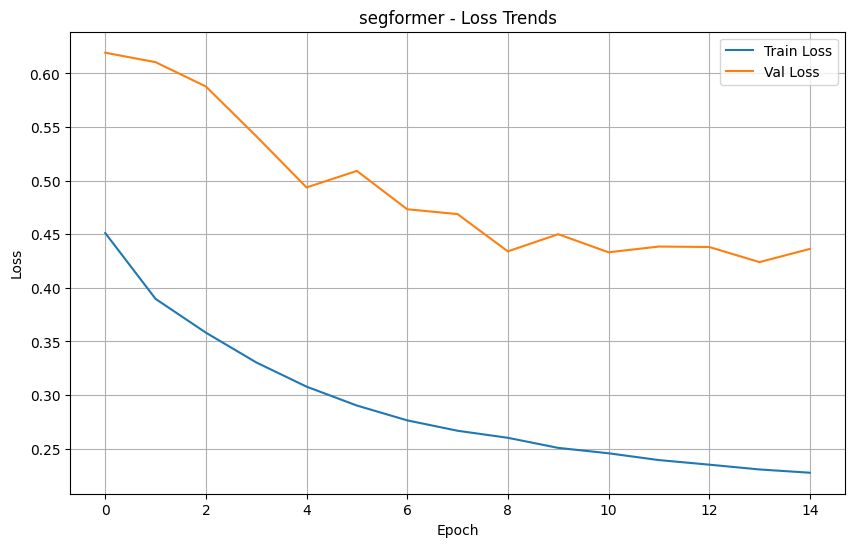

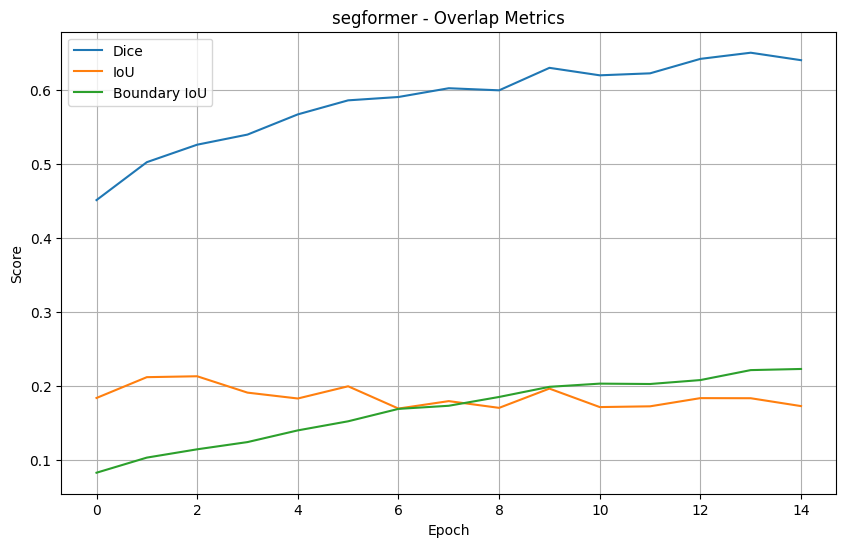

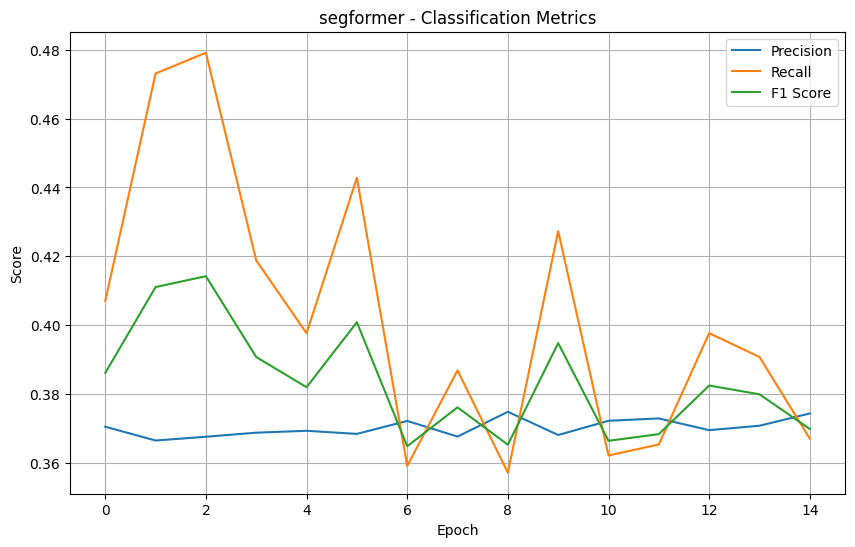

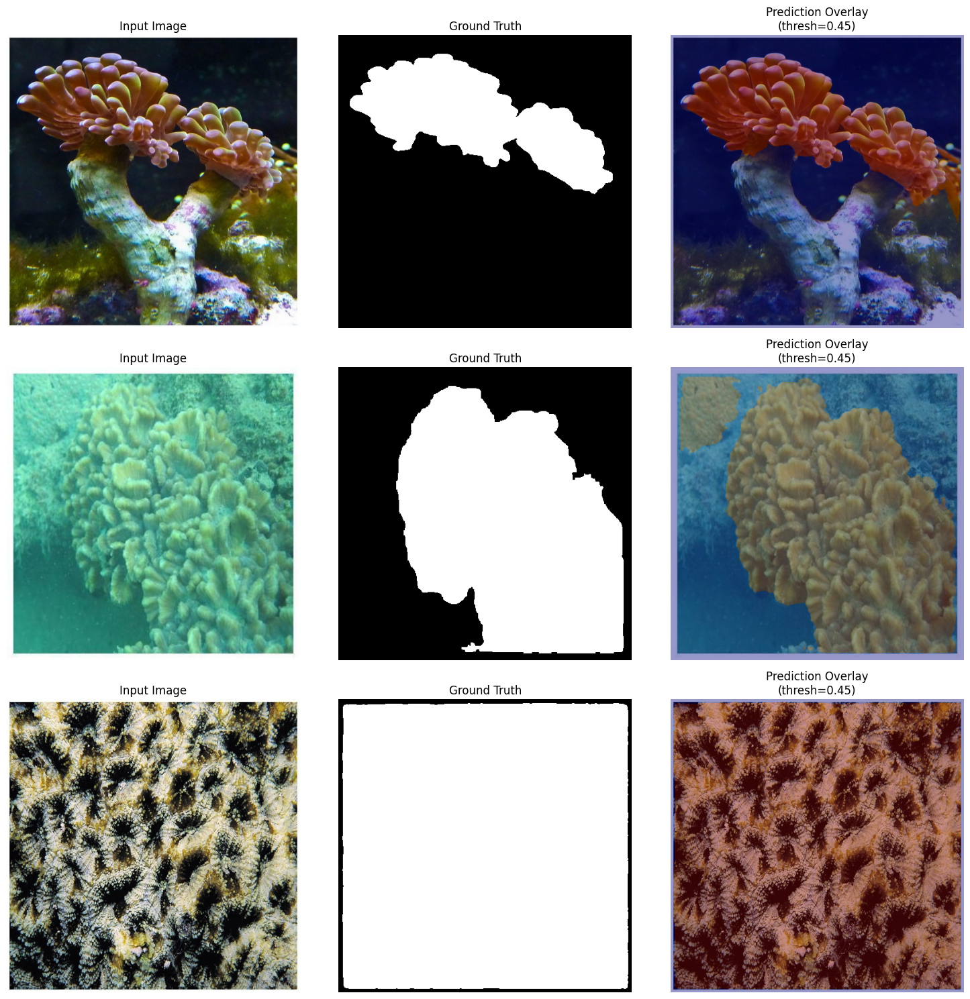


 Evaluating post-processing for model: SEGFORMER
🔬 Metric Comparison (Before vs. After Post-processing):


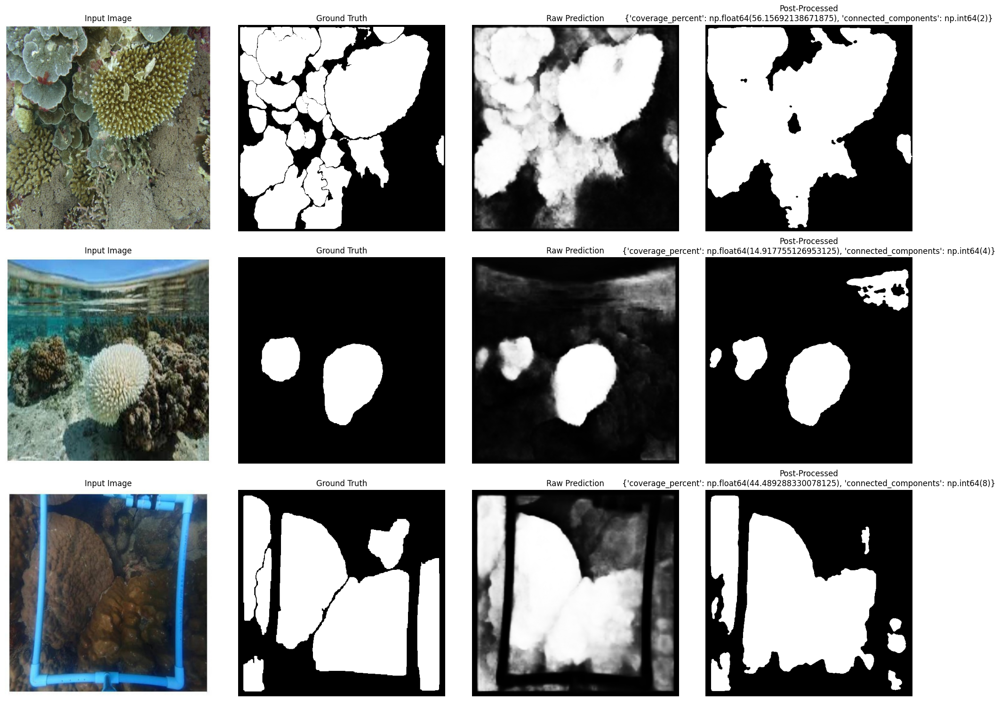


 Running Sliding Occlusion for SEGFORMER


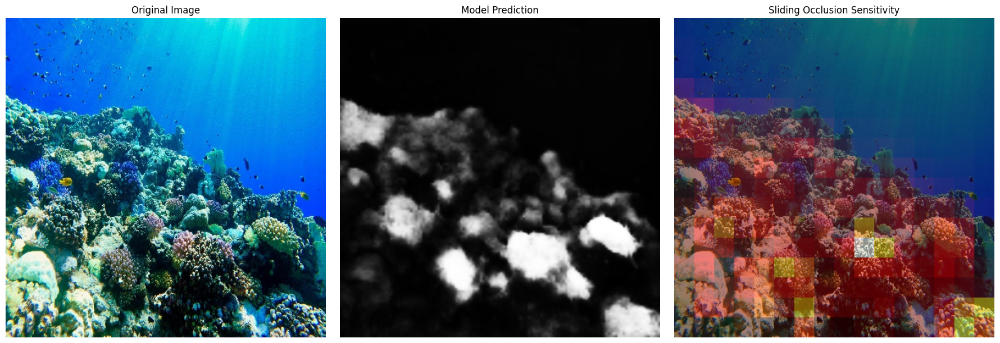

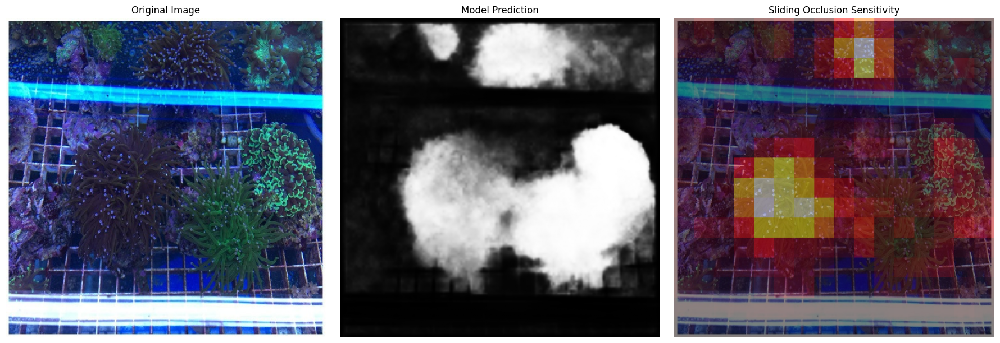

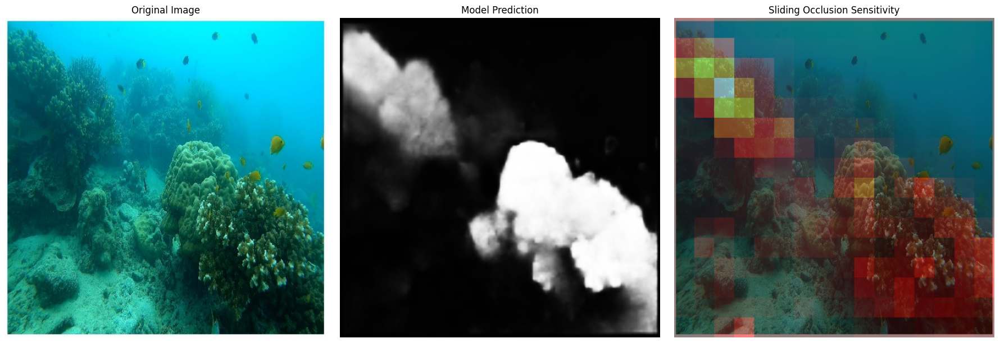


 Evaluating robustness for SEGFORMER via black box occlusion
Running fixed black box evaluation on 3 samples...

 Sample 606:
   Dice drop: 0.1215 → 0.1215
   IoU drop:  0.0871 → 0.0868
   F1 drop:   0.1602 → 0.1598


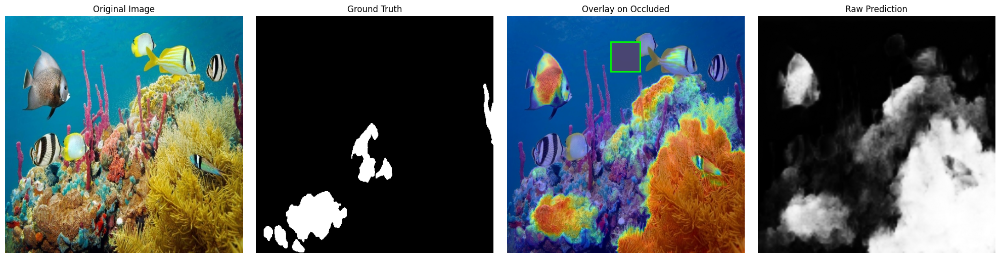


 Sample 647:
   Dice drop: 0.4057 → 0.4038
   IoU drop:  0.9564 → 0.8941
   F1 drop:   0.9777 → 0.9441


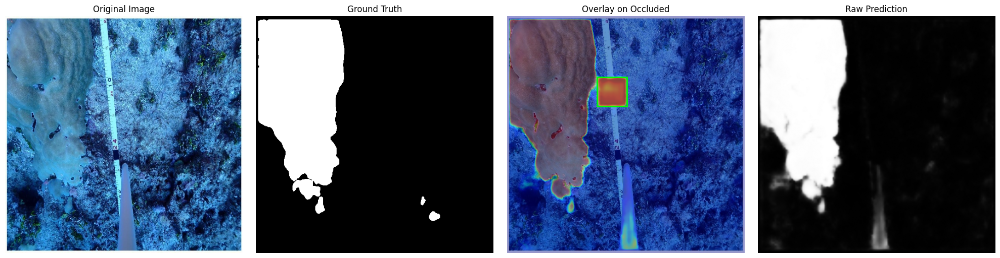


 Sample 244:
   Dice drop: 0.6138 → 0.6124
   IoU drop:  0.8876 → 0.8790
   F1 drop:   0.9405 → 0.9356


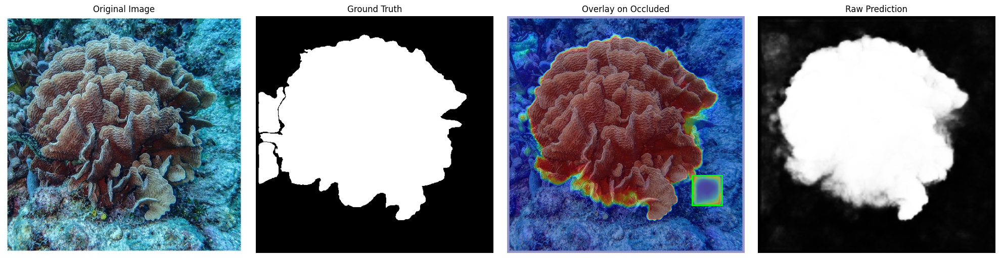


 Loading best model for SEGFORMER from: best_model_segformer.pth

 Final Test Set Metrics for SEGFORMER:
Dice:         0.6431
IoU:          0.5932
Boundary IoU: 0.2238
Precision:    0.8097
Recall:       0.8480
F1 Score:     0.8271

 SEGFORMER completed in 61.63 minutes.


In [ ]:
#%% Main Execution for A100 GPU Colab Runtime
import torch.backends.cudnn as cudnn
import time

if __name__ == "__main__":
    DEVICE = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    cudnn.benchmark = True
    print(f"Running on: {DEVICE} | GPU: {torch.cuda.get_device_name(0)}")

    for model_choice in ["segformer", "deeplab", "unet", "unet++", "bisenet", "attentionunet", "hybridnet", "hrnet"]:
        start_time = time.time()
        print(f"\n🔧 Training model: {model_choice.upper()}")

        model = initialize_model(name=model_choice).to(DEVICE)
        model_name = model.__class__.__name__.lower()

        train_dataset = CoralDataset(BASE_DIR / "train" / "images_processed",
                                     BASE_DIR / "train" / "masks", transform=train_transform)
        val_dataset = CoralDataset(BASE_DIR / "test" / "images_processed",
                                  BASE_DIR / "test" / "masks", transform=val_transform)

        train_loader = DataLoader(train_dataset, batch_size=BATCH_SIZE,
                                  shuffle=True, num_workers=4, pin_memory=True)
        val_loader = DataLoader(val_dataset, batch_size=BATCH_SIZE,
                                shuffle=False, num_workers=4, pin_memory=True)

        history = train_model(model, train_loader, val_loader, epochs=15)
        best_threshold = tune_threshold(val_loader, model)
        print(f" Best threshold for {model_choice}: {best_threshold:.2f}")

        def save_combined_plot(metrics_dict, title, ylabel, filename):
            plt.figure(figsize=(10, 6))
            for label, values in metrics_dict.items():
                if values:
                    plt.plot(values, label=label)
            plt.xlabel("Epoch")
            plt.ylabel(ylabel)
            plt.title(title)
            plt.legend()
            plt.grid(True)
            plt.savefig(BASE_DIR / filename)
            plt.show()

        save_combined_plot(
            {"Train Loss": history['train_loss'], "Val Loss": history['val_loss']},
            title=f"{model_choice} - Loss Trends", ylabel="Loss",
            filename=f"{model_choice}_loss_trends.png"
        )

        save_combined_plot(
            {"Dice": history['dice'], "IoU": history['iou'], "Boundary IoU": history['boundary_iou']},
            title=f"{model_choice} - Overlap Metrics", ylabel="Score",
            filename=f"{model_choice}_overlap_metrics.png"
        )

        save_combined_plot(
            {"Precision": history['precision'], "Recall": history['recall'], "F1 Score": history['f1']},
            title=f"{model_choice} - Classification Metrics", ylabel="Score",
            filename=f"{model_choice}_classification_metrics.png"
        )

        visualize_predictions(model, val_dataset, threshold=best_threshold)
        visualize_misclassifications(model, val_dataset, threshold=best_threshold, num_samples=10)

        print(f"\n Evaluating post-processing for model: {model_choice.upper()}")
        evaluate_postprocessing(model, val_loader, threshold=best_threshold)
        visualize_postprocessing(model, val_dataset, threshold=best_threshold)

        print(f"\n Running Sliding Occlusion for {model_choice.upper()}")
        run_sliding_occlusion_black_box(model, val_dataset, threshold=best_threshold)

        print(f"\n Evaluating robustness for {model_choice.upper()} via black box occlusion")
        run_fixed_black_box_evaluation(model, val_dataset, threshold=best_threshold)

        best_model_path = BASE_DIR / f"best_model_{model_name}.pth"
        if best_model_path.exists():
            print(f"\n Loading best model for {model_name.upper()} from: {best_model_path.name}")
            model.load_state_dict(torch.load(best_model_path, map_location=DEVICE))
        else:
            print(f" Best model checkpoint not found: {best_model_path.name}")
            print(" Proceeding with the last trained model instead.")

        model.eval()
        test_loader = DataLoader(
            CoralDataset(BASE_DIR / "test" / "images_processed", BASE_DIR / "test" / "masks", transform=train_transform),
            batch_size=BATCH_SIZE, shuffle=False, num_workers=4, pin_memory=True
        )

        total_dice = total_iou = total_biou = total_precision = total_recall = total_f1 = 0.0
        n = len(test_loader)

        with torch.no_grad():
            for images, masks in test_loader:
                images, masks = images.to(DEVICE), masks.to(DEVICE)
                outputs = model(images).sigmoid().squeeze(1)
                total_dice += dice_coeff(outputs, masks.squeeze(1)).item()
                total_iou += compute_iou(outputs, masks.squeeze(1))
                total_biou += boundary_iou(outputs, masks.squeeze(1))
                p, r, f1 = compute_metrics(outputs, masks.squeeze(1))
                total_precision += p
                total_recall += r
                total_f1 += f1

        print(f"\n Final Test Set Metrics for {model_name.upper()}:")
        print(f"Dice:         {total_dice / n:.4f}")
        print(f"IoU:          {total_iou / n:.4f}")
        print(f"Boundary IoU: {total_biou / n:.4f}")
        print(f"Precision:    {total_precision / n:.4f}")
        print(f"Recall:       {total_recall / n:.4f}")
        print(f"F1 Score:     {total_f1 / n:.4f}")

        elapsed = (time.time() - start_time) / 60
        print(f"\n {model_choice.upper()} completed in {elapsed:.2f} minutes.")
